## Anemia Notebook 2

**The transcriptomic landscape of normal and ineffective erythropoiesis at single cell resolution**

*Raymond T. Doty¹, Christopher Lausted², Adam D. Munday¹, Zhantao Yang¹, Xiaowei Yan², Changting Meng², Qiang Tian²³, Janis L. Abkowitz¹*

¹Department of Medicine, Division of Hematology, University of Washington; Seattle, Washington, USA.  ²Institute for Systems Biology; Seattle, Washington, USA.  ³Current address: National Research Center for Translational Medicine, Ruijin Hospital Affiliated to Shanghai Jiao Tong University School of Medicine; Shanghai, China. 

This notebook performs the data analysis described in the manuscript.

```
Date: 220415
Authors: Christopher Lausted, Raymond Doty
```

In [ ]:
## Show when this notebook was last executed. 
import datetime, pytz
print(datetime.datetime.now(pytz.timezone('America/Vancouver')).strftime("%I:%M %p - %e %B %Y - %A"))

05:04 PM - 12 October 2021 - Tuesday


### 1) Install tools

Intermediate files can be save to a cloud service like pCloud.  Other options are Google Drive, NCBI, and Dryad.  

Google Colab, along with the ScanPy, ScVelo, BBKNN, and other single-cell libraries are constantly changing.  Along with a script that worked in September 2021, use Github to keep the installation versions compatible.

In [ ]:
%%writefile install_scanpy.sh
#!/usr/bin/env bash
## This script installs required libraries using apt and pip.  
## For the latest version, pull from Github. 
:> install.log  
apt install -q python3-igraph python3-h5py python3-networkx  >> install.log
pip install -q albumentations==1.0.3  >> install.log
pip install -q scanpy==1.7.1 scvelo==0.2.3  >> install.log
pip install -q leidenalg magic-impute bbknn scrublet louvain  >> install.log

In [ ]:
%%bash
## Get updated installer script from Github.
git -C ScanPy_for_Colab pull || git clone https://github.com/lausted/ScanPy_for_Colab.git
cp ./ScanPy_for_Colab/install_scanpy.sh . 

In [ ]:
%%bash
## Run installer script. 
bash install_scanpy.sh
tail -n 4 install.log

In [ ]:
## Set up ScanPy
import warnings, gc, magic, bbknn
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import scanpy as sc
import scanpy.external as sce
import scvelo as scv
import loompy, scipy, bbknn

#sc.logging.print_versions()
print("scanpy ==", sc.__version__)
print("scvelo ==", scv.__version__)
print("loompy ==", loompy.__version__)
print("magic-impute ==", magic.__version__)
np.random.seed(0)  ## We wish to make this notebook reproducible.
sc.settings.verbosity=0  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=90)
#warnings.filterwarnings('ignore')

scanpy == 1.7.1
scvelo == 0.2.3
loompy == 3.0.6
magic-impute == 3.0.0


### 2) Normalize and Filter

#### Download Data

In [ ]:
%%bash
## Aggregated veloctyo and protein data; 1400 MB takes 20s. 
MYURL="https://filedn.com/lqG7xVB6iHlJD0QAnosrwfH/data/anemia2021/"
MYFILE="step01_aggr_5exp_211012.h5ad"
[ -e ${MYFILE} ] || wget -q "${MYURL}${MYFILE}"
ls -lh ${MYFILE}

-rw-r--r-- 1 root root 1.4G Oct 13 00:24 step01_aggr_5exp_211012.h5ad


In [ ]:
## Load data.  74214 cells x 33538 genes.  Takes 60 s.  
ad1 = sc.read_h5ad("step01_aggr_5exp_211012.h5ad")
ad1

AnnData object with n_obs × n_vars = 74214 × 33538
    obs: 'day', 'barcode', 'id', 'batch', 'doublet_score', 'predicted_doublet', 'prob', 'trajectoryb', 'hap', 'tsb-CD70', 'tsb-CD36', 'tsb-CD71', 'tsb-CD3', 'tsb-CD235a', 'tsb-CD14', 'tsb-CD117', 'tsb-CD11b', 'tsb-CD4', 'tsb-CD8', 'tsb-CD11c', 'tsb-CD16', 'tsb-CD19', 'tsb-CD45', 'tsb-CD56', 'exp'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    uns: 'id_colors'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [ ]:
## First filter genes.  Remove 14736 and keep 18802. 
## (Filtering by cells first may lead to crash.) 
scv.pp.filter_genes(ad1, min_cells=20)
ad1.shape

Filtered out 14711 genes that are detected in less than 20 cells (spliced).


(74214, 18827)

In [ ]:
## Second, filter cells.   Remove 229 and keep 69912. 
## It also counts n_genes.  
sc.pp.filter_cells(ad1, min_genes=40) 
ad1.shape

(73204, 18827)

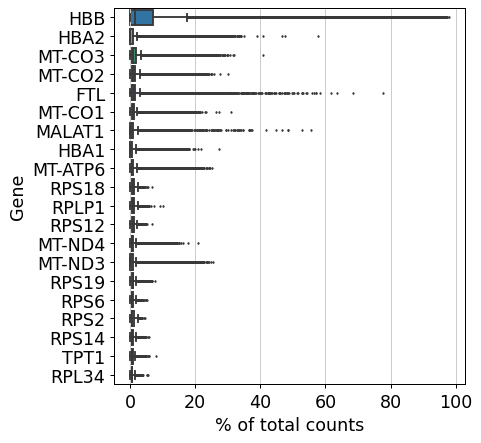

In [ ]:
## Top gene list very similar to previous analyses. 
sc.pl.highest_expr_genes(ad1, n_top=20)

In [ ]:
## Note mitochondrial genes and get some statistics. 
ad1.var['mt'] = ad1.var_names.str.startswith('MT-')  
sc.pp.calculate_qc_metrics(ad1, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

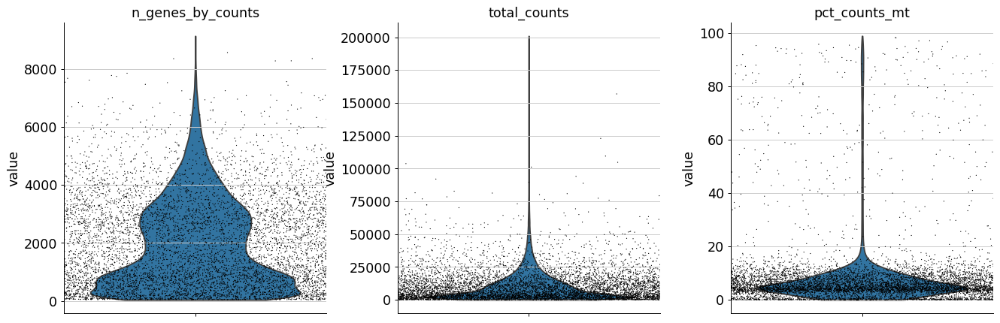

In [ ]:
sc.pl.violin(ad1, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'], jitter=5.0, multi_panel=True)

In [ ]:
## How many cells over 15% Mito?  Discard these later. 
print("Cells over 15% Mito:", len(ad1[ad1.obs['pct_counts_mt']>15]))
## How many cells over 25% Mito?  Discard these 4302 now.  69912 remain. 
print("Cells over 25% Mito:", len(ad1[ad1.obs['pct_counts_mt']>25]))
ad1 = ad1[ad1.obs['pct_counts_mt']<=25]
ad1

Cells over 15% Mito: 4869
Cells over 25% Mito: 3524


View of AnnData object with n_obs × n_vars = 69680 × 18827
    obs: 'day', 'barcode', 'id', 'batch', 'doublet_score', 'predicted_doublet', 'prob', 'trajectoryb', 'hap', 'tsb-CD70', 'tsb-CD36', 'tsb-CD71', 'tsb-CD3', 'tsb-CD235a', 'tsb-CD14', 'tsb-CD117', 'tsb-CD11b', 'tsb-CD4', 'tsb-CD8', 'tsb-CD11c', 'tsb-CD16', 'tsb-CD19', 'tsb-CD45', 'tsb-CD56', 'exp', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'id_colors'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [ ]:
gc.collect()

43469

In [ ]:
## Save a copy of n_counts as counts to avoid overwriting by scvelo.pp.normalize_per_cell. 
ad1.obs['counts'] = ad1.obs['total_counts'].astype(int)

Trying to set attribute `.obs` of view, copying.


#### Normalize and Logarithmize

In [ ]:
## Normalize mRNA.  Use scvelo to also normalize splice layers. 
sc.pp.normalize_total(ad1, target_sum=1e4)

In [ ]:
## Logarithmize
scv.pp.log1p(ad1)

In [ ]:
## Normalize surface proteins. Antibody counts per 10k mRNA reads.
## Then also logarithmize. 
## e.g. 'tsb-CD36'
proteins = [x for x in ad1.obs_keys() if x.startswith("tsb")]
for protein in proteins:
  ad1.obs[protein] = np.log1p(ad1.obs[protein] * 1e4 / ad1.obs['counts'])

In [ ]:
print("Average tsb-CD36:", np.average(ad1.obs['tsb-CD36']))

Average tsb-CD36: 2.686094128972945


In [ ]:
## Identify highly variable genes using typical parameters. 
sc.pp.highly_variable_genes(ad1, min_mean=0.0125, max_mean=3, min_disp=0.5)

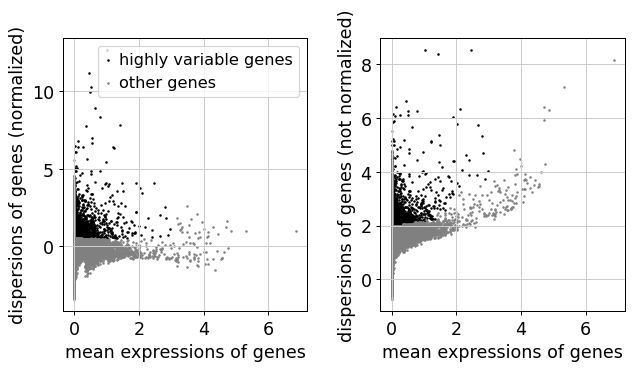

In [ ]:
sc.pl.highly_variable_genes(ad1)

In [ ]:
## Save a copy of the log norm raw gene expression, before any scaling. 
ad1.layers['X0'] = ad1.X 

#### Scale per exp

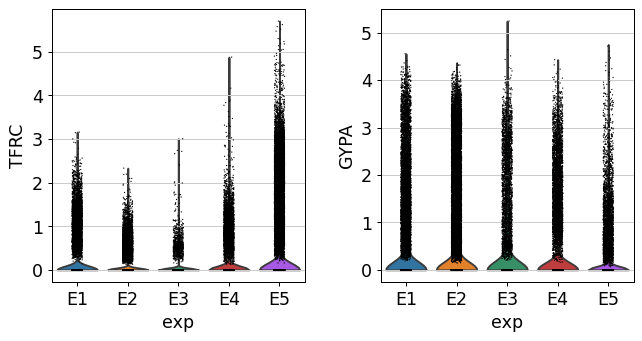

In [ ]:
## Show how TFRC varies, especially E5.  
sc.pl.violin(ad1, ['TFRC', 'GYPA'], groupby='exp')

In [ ]:
## Divide annData into five exp. 
adE1 = ad1[ad1.obs['exp']=='E1']
print("Exp 1:", adE1.shape)
adE2 = ad1[ad1.obs['exp']=='E2']
print("Exp 2:", adE2.shape)
adE3 = ad1[ad1.obs['exp']=='E3']
print("Exp 3:", adE3.shape)
adE4 = ad1[ad1.obs['exp']=='E4']
print("Exp 4:", adE4.shape)
adE5 = ad1[ad1.obs['exp']=='E5']
print("Exp 5:", adE5.shape)

Exp 1: (12105, 18827)
Exp 2: (18827, 18827)
Exp 3: (7312, 18827)
Exp 4: (10761, 18827)
Exp 5: (20675, 18827)


In [ ]:
## Scale each gene to unit variance.  Don't zero center to avoid dense matrix. 
sc.pp.scale(adE1, zero_center=False, max_value=10)
sc.pp.scale(adE2, zero_center=False, max_value=10)
sc.pp.scale(adE3, zero_center=False, max_value=10)
sc.pp.scale(adE4, zero_center=False, max_value=10)
sc.pp.scale(adE5, zero_center=False, max_value=10)

In [ ]:
## Re-merge all AnnData objects.  Takes 10 sec. 
batches = ["E1", "E2", "E3", "E4", "E5"]
ad1 = sc.AnnData.concatenate(*[adE1, adE2, adE3, adE4, adE5], batch_categories=batches, batch_key='exper', join='inner')
ad1.obs.drop(columns=['exper'], inplace=True) 
ad1.shape

(69680, 18827)

In [ ]:
gc.collect()

28076

In [ ]:
## Create a copy of scaled anndata as layers['X1']
ad1.layers['X1'] = ad1.X 
ad1.X = ad1.layers['X1'] 

... storing 'day' as categorical
... storing 'barcode' as categorical
... storing 'id' as categorical
... storing 'batch' as categorical
... storing 'exp' as categorical


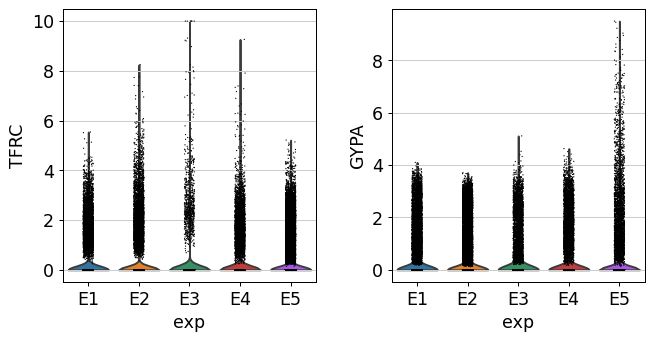

In [ ]:
## Show how TFRC varies, especially E5.  
sc.pl.violin(ad1, ['TFRC', 'GYPA'], groupby='exp')

#### Cell lineage gene panel scoring

**Maybe update HSC markers?**

CD34+CD144+CD45+KIT+CD90+Endoglin+RUNX1+CD38−/loCD45RA−

https://www.nature.com/articles/s41422-019-0228-6


In [ ]:
## Cell type marker panels.  Takes 61 sec.
## Six for each.  From literature, confirmed here. 
import time
markers = dict(
  Tcell = ['CD3D','TRAC','CD8A','CD4','CXCR4'] + ['BTG1'], 
  Mac = ['TYROBP','FCER1G','CD14','S100A8','S100A9','LYZ'], 
  Bcell = ['CD27','CD74','CD79B','IGKC','IGHM','MZB1'], 
  DC = ['PLD4','ITM2C','JCHAIN','CD40','PLIN2','LGALS3BP'], 
  NK = ['GNLY','NKG7','PRF1','KLRB1','GZMA', 'CTSW'], 
  Neu = ['PRSS57','SMIM24','ELANE','AZU1','PRTN3','CFD'],
  Ery = ['HBA1','CA1','SLC4A1','GYPA','TFRC','HMGA1'], 
  Meg = ['CD9', 'LOX', 'VWF', 'NFIB', 'TGFB1', 'FLI1'],
  Mast = ['CCL2', 'CREB3L1', 'GNAI1', 'PLAU', 'KCNE3', 'SRGN'], 
  MPP = ['KIT', 'CCL2', 'GATA2', 'GATA4', 'RUNX1', 'TRIM33'], 
  CLP = ['SPINK2','DNTT','CD79A','EBF1','IGHM'],  
  Mito = ['MT-ND1','MT-ND3','MT-ND4','MT-CO2','MT-CYB'],  
  Hb = ['HBA1','HBA2','HBB','HBG1','HBG2','HBD','HBE1','HBZ']
  )

## This may crash Google Colab if not a high-RAM runtime.
for panel,keygenes in markers.items():
  sc.tl.score_genes(ad1, keygenes, gene_pool=None, score_name=panel)
  gc.collect(); time.sleep(2)

In [ ]:
## Calcuate cell cycle and save in obs['phase']
s_genes = [ 'MCM5', 'PCNA', 'TYMS', 'FEN1', 'MCM2', 'MCM4', 'RRM1', 'UNG', 'GINS2', 'MCM6', 'CDCA7', 'DTL', 
  'PRIM1', 'UHRF1', 'MLF1IP', 'HELLS', 'RFC2', 'RPA2', 'NASP', 'RAD51AP1', 'GMNN', 'WDR76', 'SLBP', 'CCNE2', 
  'UBR7', 'POLD3', 'MSH2', 'ATAD2', 'RAD51', 'RRM2', 'CDC45', 'CDC6', 'EXO1', 'TIPIN', 'DSCC1', 'BLM', 
  'CASP8AP2', 'USP1', 'CLSPN', 'POLA1', 'CHAF1B', 'BRIP1', 'E2F8' ]
g2m_genes = [ 'HMGB2', 'CDK1', 'NUSAP1', 'UBE2C', 'BIRC5', 'TPX2', 'TOP2A', 'NDC80', 'CKS2', 
  'NUF2', 'CKS1B', 'MKI67', 'TMPO', 'CENPF', 'TACC3', 'FAM64A', 'SMC4', 'CCNB2', 'CKAP2L', 'CKAP2', 
  'AURKB', 'BUB1', 'KIF11', 'ANP32E', 'TUBB4B', 'GTSE1', 'KIF20B', 'HJURP', 'CDCA3', 'HN1', 'CDC20', 
  'TTK', 'CDC25C', 'KIF2C', 'RANGAP1', 'NCAPD2', 'DLGAP5', 'CDCA2', 'CDCA8', 'ECT2', 'KIF23', 'HMMR', 
  'AURKA', 'PSRC1', 'ANLN', 'LBR', 'CKAP5', 'CENPE', 'CTCF', 'NEK2', 'G2E3', 'GAS2L3', 'CBX5', 'CENPA' ] 
s_genes = [x for x in s_genes if x in ad1.var_names]
g2m_genes = [x for x in g2m_genes if x in ad1.var_names]

sc.tl.score_genes_cell_cycle(ad1, s_genes=s_genes, g2m_genes=g2m_genes) 

In [ ]:
ad1.uns['markers'] = markers
ad1.uns['markers']

{'Bcell': ['CD27', 'CD74', 'CD79B', 'IGKC', 'IGHM', 'MZB1'],
 'CLP': ['SPINK2', 'DNTT', 'CD79A', 'EBF1', 'IGHM'],
 'DC': ['PLD4', 'ITM2C', 'JCHAIN', 'CD40', 'PLIN2', 'LGALS3BP'],
 'Ery': ['HBA1', 'CA1', 'SLC4A1', 'GYPA', 'TFRC', 'HMGA1'],
 'Hb': ['HBA1', 'HBA2', 'HBB', 'HBG1', 'HBG2', 'HBD', 'HBE1', 'HBZ'],
 'MPP': ['KIT', 'CCL2', 'GATA2', 'GATA4', 'RUNX1', 'TRIM33'],
 'Mac': ['TYROBP', 'FCER1G', 'CD14', 'S100A8', 'S100A9', 'LYZ'],
 'Mast': ['CCL2', 'CREB3L1', 'GNAI1', 'PLAU', 'KCNE3', 'SRGN'],
 'Meg': ['CD9', 'LOX', 'VWF', 'NFIB', 'TGFB1', 'FLI1'],
 'Mito': ['MT-ND1', 'MT-ND3', 'MT-ND4', 'MT-CO2', 'MT-CYB'],
 'NK': ['GNLY', 'NKG7', 'PRF1', 'KLRB1', 'GZMA', 'CTSW'],
 'Neu': ['PRSS57', 'SMIM24', 'ELANE', 'AZU1', 'PRTN3', 'CFD'],
 'Tcell': ['CD3D', 'TRAC', 'CD8A', 'CD4', 'CXCR4', 'BTG1']}

In [ ]:
gc.collect()

607

#### Filter AnnData: ad1 to ad2

Create ad2, key genes and highly variable genes.  Save a copy of ad1  

In [ ]:
## Mark key genes & proteins that we must keep.
keygenes = ["HBB","HBA1","GYPA","GYPB","GATA1","TAL1","KLF1","KLF3","ZFPM1","EIF2AK1","E2F2","TFRC","SLC25A37",
  "SLC48A1","ALAS2","HMBS","FECH","TOP2A","KIF11","HEMGN","RPL35","RPL8","RPL4","RPL5","RPL11","RPS14","RPS19",
  "MRPL57","MRPL40","CDKN1A","SLC7A11","GPX4","PRDX2","GPX1","COX6B1","CYC1","NDUFA8","NDUFB6","SDHB","PSMA2",
  "PSMB2","SMC2","KIF22","KIF2A","SMC1A","SMC4","KIF2C","AURKA","AURKB","GCLM","FTH1","FTL","MAF1","KEAP1",
  "SLC52A2", "SLC20A1", "SLC20A2", "XPR1", "FLVCR1", "SLC5A6", "SLC1A5", "SLC2A1", "SLC4A1", "KIT", "CD36"
  "TRIB2", "CA1", "CA2", "SPINK2", "FCER1A", "THY1" ]
ad1.var['keygene'] = [x in keygenes for x in list(ad1.var_names)]
print(sum(list(ad1.var['keygene'])))

66


In [ ]:
## Mark most variable genes with field 'highly_variable'
sc.pp.highly_variable_genes(ad1, n_top_genes=7500, flavor='cell_ranger', subset=False, inplace=True, batch_key='exp')

... storing 'phase' as categorical


In [ ]:
## Keep important 7545 genes. 
ad2 = ad1[ :, (ad1.var['highly_variable'] | ad1.var['keygene']) ]
ad2.shape

(69680, 7545)

In [ ]:
gc.collect()

353

#### Optional copy of normalized data.

In [ ]:
## Save to virtual machine temporary disk.  
ad2.write("step02_normalized_211012.h5ad", compression='gzip')  ## 995 MB file.
!ls -lh "step02_normalized_211012.h5ad"

-rw-r--r-- 1 root root 995M Oct 13 00:28 step02_normalized_211012.h5ad


In [ ]:
%%bash
## Filtered Scaled Log Norm data. 
MYURL="https://filedn.com/lqG7xVB6iHlJD0QAnosrwfH/data/anemia2021/"
MYFILE="step02_normalized_211012.h5ad"
[ -e ${MYFILE} ] || wget -q "${MYURL}${MYFILE}"

In [ ]:
## Reload data, if needed.  69680 cells x 7545 genes. 
#ad2 = sc.read_h5ad("step02_normalized_211012.h5ad")

### 3) Annotate Lineages

#### Add fields

Add some more fields.  Remove unidentified cells. 

In [ ]:
## Define field "condition"
ad2.obs['condition'] = ad2.obs['id']
ad2.obs['condition'] = ad2.obs['condition'].replace("N1","normal").replace("N2","normal").replace("N3","normal")
ad2.obs['condition'] = ad2.obs['condition'].replace("N4","normal").replace("N5","normal")
ad2.obs['condition'] = ad2.obs['condition'].replace("N6","normal").replace("N7","normal")
ad2.obs['condition'] = ad2.obs['condition'].replace("D1","anemia").replace("D2","anemia")
ad2.obs['condition'] = ad2.obs['condition'].replace("M1","anemia").replace("M2","anemia")
print(set(ad2.obs['condition']))

{nan, 'unassigned', 'normal', 'unknown', 'anemia', 'doublet'}


In [ ]:
## Remove doublets, etc.  Keep 65705 cells. 
ad2 = ad2[(ad2.obs['condition']=='anemia') | (ad2.obs['condition']=='normal')]
print(len(ad2))

65716


In [ ]:
## Define field 10xG "kit"
ad2.obs['kit'] = ad2.obs['exp']
ad2.obs['kit'] = ad2.obs['kit'].replace("E1","v2").replace("E2","v2").replace("E3","v2")
ad2.obs['kit'] = ad2.obs['kit'].replace("E4","v3").replace("E5","v3.1")
set(ad2.obs['kit'])

Trying to set attribute `.obs` of view, copying.


{'v2', 'v3', 'v3.1'}

In [ ]:
set(ad2.obs['day'].map(str))

{'0', '3', '6'}

In [ ]:
## Previous notebooks used Day0 instead of 0.
ad2.obs['day'] = "Day" + ad2.obs['day'].astype('str')
ad2.obs['day'] = ad2.obs['day'].astype('category')
set(ad2.obs['day'])

{'Day0', 'Day3', 'Day6'}

In [ ]:
## TEMP: Remove RBCs.  HBB+ and Mito-.  
ad2 = ad2[~((ad2.obs_vector('HBB')>=2.95) & (ad2.obs['pct_counts_mt']<=0.1))]
ad2.shape

(64374, 7545)

In [ ]:
gc.collect()

25620

#### Visualize

For UMAP to show cell types, gene expression levels are important. Use unscaled ad2.X = ad2.layers['X0'] instead of scaled ad2.X = ad2.layers['X1'].  Also avoid cell-cycle-phase specific genes in choosing top 2000 genes for PCA etc. 

In [ ]:
## Switch to unscaled data. 
ad2.X = ad2.layers['X0']
ad2.X

<64374x7545 sparse matrix of type '<class 'numpy.float32'>'
	with 52469839 stored elements in Compressed Sparse Row format>

In [ ]:
## Mark 2000 most variable genes with field 'highly_variable'
sc.pp.highly_variable_genes(ad2, n_top_genes=2000, flavor='cell_ranger', subset=False, inplace=True, batch_key='phase')

In [ ]:
## Switch to scaled data. 
ad2.X = ad2.layers['X1']
ad2.X

In [ ]:
## Calculate PCA 
sc.pp.pca(ad2, svd_solver='arpack', use_highly_variable=True)

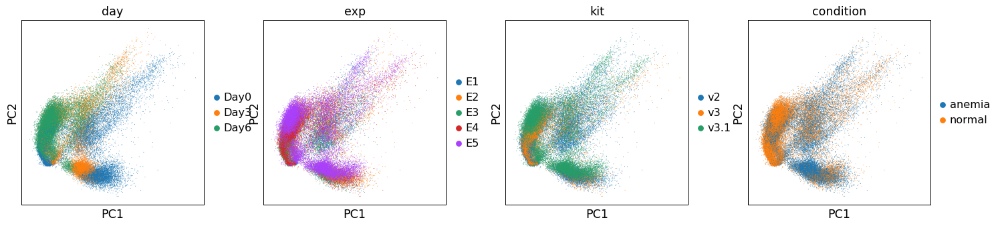

In [ ]:
## Show PCA with gene markers. 
sc.pl.pca(ad2, color=['day', 'exp', 'kit', 'condition'])

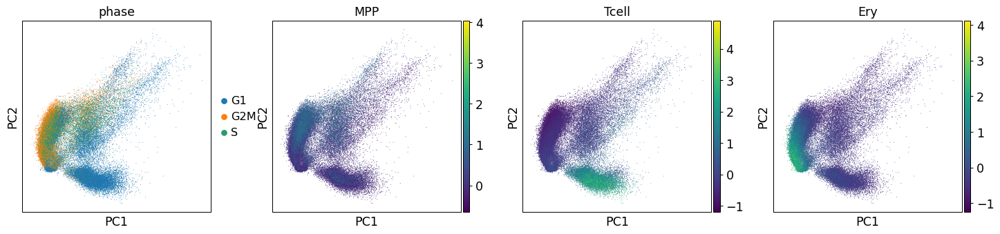

In [ ]:
## Show PCA with type-marking gene panels. 
sc.pl.pca(ad2, color=['phase', 'MPP', 'Tcell', 'Ery'])

In [ ]:
gc.collect()

In [ ]:
## Combine two fields that are relevant to batch correction.  Best.
## Exp 1 and 2 were the same.  SPARTA in 3.  75 cyles in 4.  NovaSeq in 5. 
#ad2.obs['day_exp'] = "Day" + ad2.obs['day'].astype(str) + ad2.obs['exp'].astype(str) 
ad2.obs['day_exp'] = ad2.obs['day'].astype(str) + ad2.obs['exp'].astype(str) 
ad2.obs['day_exp'] = ad2.obs['day_exp'].str.replace("Day3","DayN")
ad2.obs['day_exp'] = ad2.obs['day_exp'].str.replace("Day6","DayN")
ad2.obs['day_exp'] = ad2.obs['day_exp'].str.replace("E1","E12")
ad2.obs['day_exp'] = ad2.obs['day_exp'].str.replace("E2","E12")
print(set(ad2.obs['day_exp']))

{'DayNE5', 'Day0E5', 'DayNE12', 'Day0E4', 'DayNE3', 'Day0E3', 'DayNE4', 'Day0E12'}


In [ ]:
## Nearest Neighbors.  Correct for day and exp.
## Default method angular is best. 
bbknn.bbknn(ad2, batch_key='day_exp', n_pcs=30)

In [ ]:
## UMAP.  Takes 70 sec. 
## Reduce min_dist from default 0.5 for more clumping.   
scv.tl.umap(ad2, min_dist=0.33) 

In [ ]:
## Flip UMAP, optional. 
#ad2.obsm['X_umap'][:,0] = -ad2.obsm['X_umap'][:,0]  ## Horizontal.
#ad2.obsm['X_umap'][:,1] = -ad2.obsm['X_umap'][:,1]  ## Vertical. 

In [ ]:
## Graph-based Clustering.  Takes 60 sec. 
## Higher resolution >1 for more clusters. 
sc.tl.leiden(ad2, resolution=1.0) 
scv.tl.louvain(ad2, resolution=1.0)

... storing 'day_exp' as categorical


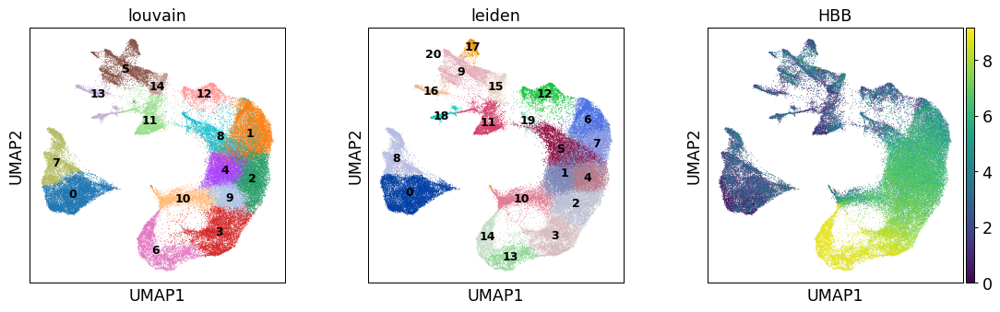

In [ ]:
## The leiden cluster correponds more closely to cell type gene panels. 
#sc.pl.umap(ad2, color=['louvain', 'leiden'], wspace=0.3)
sc.pl.umap(ad2, color=['louvain', 'leiden', 'HBB'], legend_loc='on data', legend_fontsize=10, layer='X0')

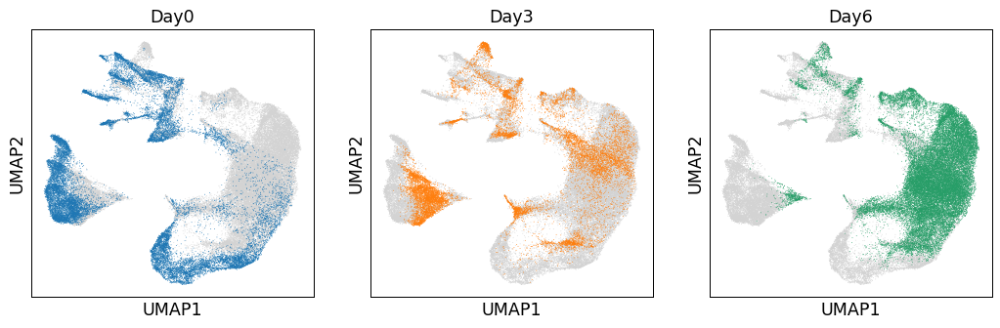

In [ ]:
## UMAPs of Day 0, 3, 6 samples individually.   
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(3*4+2, 4))
#colors = dict(N4="blue", N5="green", D1="magenta", M1="red", N1="cyan", N2="purple", N3="aqua", D2="orange") 
#palette = [colors[x[0:2]] for x in list(ad2.obs['batch'].cat.categories)]
axes[0] = sc.pl.umap(ad2, color=['day'], groups=['Day0'], ax=axes[0], show=False, title="Day0", legend_loc=None)
axes[1] = sc.pl.umap(ad2, color=['day'], groups=['Day3'], ax=axes[1], show=False, title="Day3", legend_loc=None)
axes[2] = sc.pl.umap(ad2, color=['day'], groups=['Day6'], ax=axes[2], show=False, title="Day6", legend_loc=None)
#fig.tight_layout()

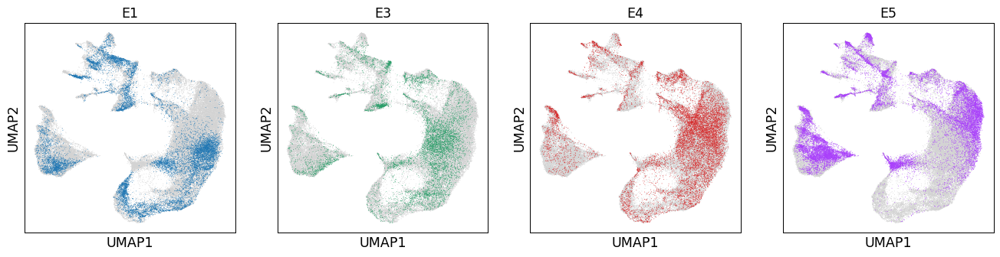

In [ ]:
## UMAPs of exp individually  
fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(4*4+2, 4))
axes[0] = sc.pl.umap(ad2, color=['exp'], groups=['E1'], ax=axes[0], show=False, title="E1", legend_loc=None)
axes[1] = sc.pl.umap(ad2, color=['exp'], groups=['E3'], ax=axes[1], show=False, title="E3", legend_loc=None)
axes[2] = sc.pl.umap(ad2, color=['exp'], groups=['E4'], ax=axes[2], show=False, title="E4", legend_loc=None)
axes[3] = sc.pl.umap(ad2, color=['exp'], groups=['E5'], ax=axes[3], show=False, title="E5", legend_loc=None)
#fig.tight_layout()

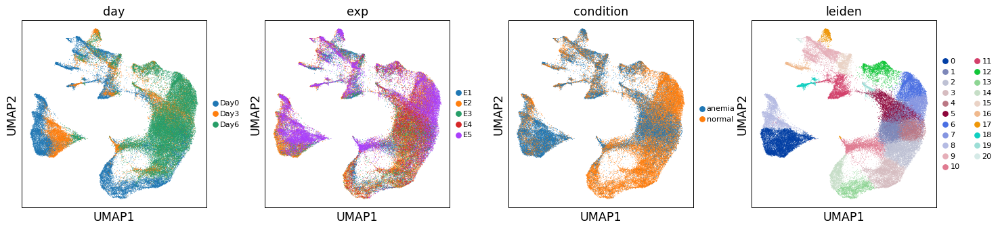

In [ ]:
## UMAPs of sample types.  
#scv.pl.umap(ad2, color=['day', 'exp', 'condition', 'leiden'], wspace=0.1, dpi=120, legend_fontsize=9)
sc.pl.umap(ad2, color=['day', 'exp', 'condition', 'leiden'], wspace=0.2, legend_fontsize=9)

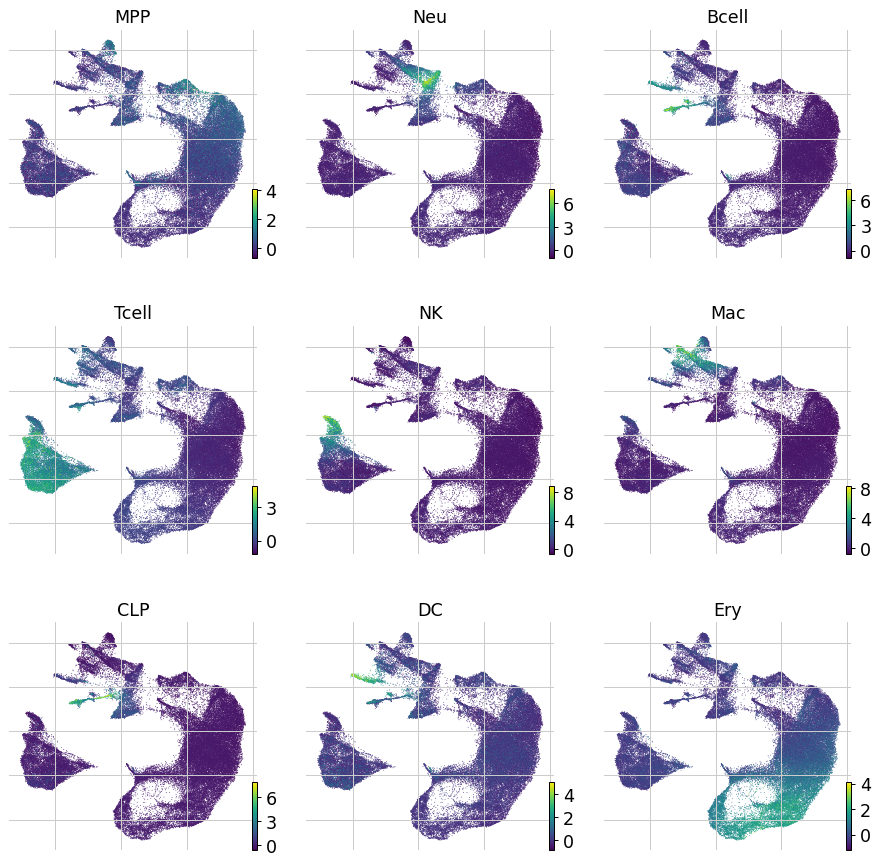

In [ ]:
## Plot cell type panels.  (See how order is determined later, from dendrogram)
typemarkers = ['MPP', 'CLP', 'Ery', 'Meg', 'Neu', 'Mac', 'Bcell', 'NK', 'Tcell', 'DC', 'Mast', 'phase']
typemarkers = ['MPP', 'Neu', 'Bcell', 'Tcell', 'NK', 'Mac', 'CLP', 'DC', 'Ery']
scv.pl.umap(ad2, color=typemarkers, ncols=3) 

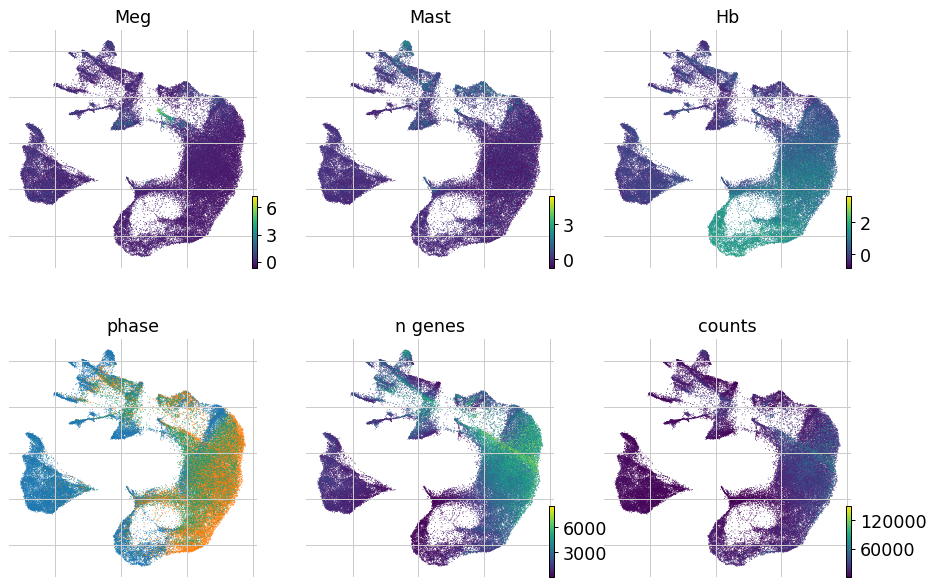

In [ ]:
## The other markers, not needed for paper, but helpful.  
scv.pl.umap(ad2, color=['Meg', 'Mast', 'Hb', 'phase', 'n_genes', 'counts'], ncols=3) 

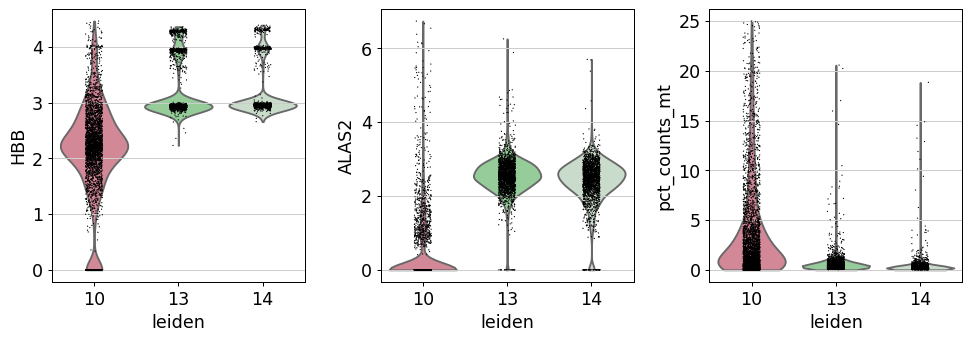

In [ ]:
## Show RBCs in cluster 10 (Trajector B) and 14 (Erythroid terminal) are HBB+ and Mito-. 
keep = (ad2.obs['leiden']=='10') | (ad2.obs['leiden']=='13') | (ad2.obs['leiden']=='14')
sc.pl.violin(ad2[keep], ['HBB', 'ALAS2', 'pct_counts_mt'], groupby='leiden', order=['10','13','14']) 
#sc.pl.scatter(ad2[keep], x='HBB', y='pct_counts_mt', color='leiden')

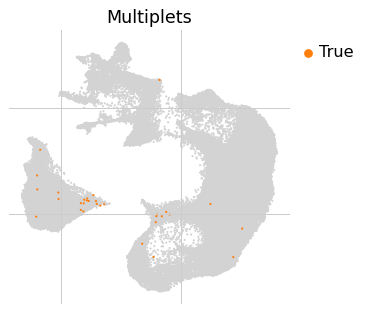

In [ ]:
## Doublets are rare and not clustered. 
ad2.obs['predicted_doublet'] = ad2.obs['predicted_doublet'].astype('category')
scv.pl.umap(ad2, color=['predicted_doublet'], size=12, groups='True', title='Multiplets') 

In [ ]:
## Calculate total transcripts in each cell.  20 sec. 
ad2.obs['n_spliced'] = [np.sum(ad2.var_vector(cell, layer='spliced')) for cell in ad2.obs_names]
ad2.obs['n_unspliced'] = [np.sum(ad2.var_vector(cell, layer='unspliced')) for cell in ad2.obs_names]
## Log ratio of mean.  Clipped for display. 
ad2.obs['unspliced_ratio'] = ad2.obs['n_unspliced'] / ad2.obs['n_spliced']
avg = np.mean(ad2.obs['unspliced_ratio'])
ad2.obs['unspliced_ratio'] = np.log2(ad2.obs['unspliced_ratio'] / avg)
ad2.obs['unspliced_ratio'] = np.clip(ad2.obs['unspliced_ratio'], -2, 2)

#### Cell type identification

In [ ]:
ad2.obs['cluster'] = ad2.obs['leiden']

In [ ]:
## Marker genes for each leiden/louvain cluster. 
sc.tl.rank_genes_groups(ad2, groupby='cluster', use_raw=False)

In [ ]:
## Here is a way to list all of the significantly enriched genes in a cluster.
## The biggest cluster (0) is usually a T cell. 
def significant_genes(anndata, cluster, threshold=0.05): 
  ## Get the list of 100 genes and their p-values.
  names = list(pd.DataFrame(anndata.uns['rank_genes_groups']['names']).iloc[:,cluster])
  pvals = list(pd.DataFrame(anndata.uns['rank_genes_groups']['pvals']).iloc[:,cluster])
  ## Count how many have p-values that are significant. 
  n = len([1 for p in pvals if p < threshold]) 
  return list(names[:n])

print("cluster=0:", *significant_genes(ad2, 0))

cluster=0: BTG1 TRAC HLA-C RPL11 CD52 CD48 TRBC2 RPS14 CD3E HLA-E KLF2 GIMAP7 PNRC1 PIK3IP1 CD3G RPS19 FYB1 CD2 PTPRC TRBC1 CCR7 ARHGDIB BCL11B LCK CD7 CYTIP RPL5 SELL GIMAP4 LEF1 AES SPOCK2 CLEC2D CD27 HCST GPSM3 TNFAIP3 TMEM123 CORO1A MAL CD37 RARRES3 B2M JUN STK17B ETS1 ARL4C HLA-F RPL35 CD69 RHOH CD247 FXYD5 FCMR EVI2B CD6 C6orf48 RCAN3 CALM1 SYNE2 NFKBIA AL445686.2 BIN1 TRAF3IP3 GZMM HLA-B NELL2 SLFN5 GIMAP2 PTGER4 ZFP36 ARHGAP45 GPR183 TOB1 LEPROTL1 ANXA2R EVL TMEM243 IRF1 MAML2 DUSP1 TNFAIP8 PASK CD8A SELENOM PBXIP1 FAM102A PSMB9 RASGRP1 LDLRAP1 ITK CD8B TRAT1 SOCS3 ARID5B IL16 MGAT4A AC058791.1 ABLIM1 SLC38A1 LINC02446 FNBP1 JAK1 TC2N IFITM1 GBP2 DNAJB1 CD28 IL32 SCML4 CD5 CCSER2 THEMIS SKAP1 FOS TXK CD44 GMFG STMN3 C16orf54 INPP4B P2RY10 ZBTB20 CAMK4 RORA CYTH1 DGKA TSHZ2 RIPOR2 IKZF3 IFI16 ZAP70 ARRDC3 ZNF331 OXNAD1 TNFRSF25 FBXO32 FLT3LG BCL2 SORL1 PDE3B AC026979.2 GPR171 RASGRP2 SEPT6 ICOS GIMAP6 RETREG1 SIT1 TRABD2A TAGAP SUSD3 RNF125 TNRC6C RCSD1 CDC42SE1 TGFBR2 A1BG BACH

In [ ]:
## A table to help determine cell type for each cluster.
df = pd.DataFrame()
## Loop through clusters.
for j in list(set(ad2.obs['cluster'])): 
  adj = ad2[ad2.obs['cluster']==j]
  ## Loop through cell types. 
  typemarkers = ['MPP', 'CLP', 'Ery', 'Meg', 'Neu', 'Mac', 'Bcell', 'NK', 'Tcell', 'DC', 'Mast']
  for i in typemarkers:  
    df.loc[i,j] = np.around(np.average(adj.obs_vector(i)), 2)
df.reindex(sorted(df.columns), axis=1)

,0,1,10,11,12,13,14,15,16,17,18,19,2,20,3,4,5,6,7,8,9
MPP,-0.07,0.07,0.06,0.17,0.56,-0.07,-0.03,0.11,-0.12,0.50,-0.09,0.06,-0.03,-0.16,-0.09,0.05,0.12,0.47,0.35,-0.08,-0.01
CLP,-0.03,-0.15,-0.03,1.28,-0.15,-0.03,-0.01,0.12,0.43,-0.30,2.87,-0.19,-0.15,-0.23,-0.08,-0.19,-0.20,-0.19,-0.22,-0.12,-0.17
Ery,-0.37,-0.10,0.27,-0.46,-0.52,1.49,0.96,-0.39,-0.49,-0.45,-0.38,-0.56,0.59,-0.48,1.47,-0.00,-0.43,-0.39,-0.23,-0.41,-0.47
Meg,0.02,-0.15,-0.04,0.26,0.05,-0.05,-0.02,-0.06,-0.06,0.21,0.10,2.56,-0.20,0.13,-0.12,-0.21,-0.02,0.03,-0.17,0.09,0.02
Neu,-0.19,-0.31,-0.07,0.47,0.32,-0.02,0.03,3.67,-0.25,-0.15,-0.21,-0.26,-0.30,0.43,-0.17,-0.35,-0.24,-0.36,-0.45,-0.22,0.79
Mac,-0.14,-0.30,-0.01,-0.20,0.09,0.00,0.06,0.20,0.63,1.59,-0.16,-0.09,-0.25,2.15,-0.14,-0.29,-0.36,-0.34,-0.40,0.07,2.42
Bcell,0.15,-0.30,-0.05,0.61,-0.19,-0.00,0.03,-0.00,2.18,-0.06,3.39,-0.36,-0.28,0.60,-0.15,-0.35,-0.28,-0.37,-0.41,0.14,0.20
NK,0.05,-0.23,-0.06,-0.06,-0.08,0.00,0.02,-0.01,-0.19,-0.35,-0.12,-0.14,-0.23,-0.19,-0.12,-0.27,-0.20,-0.29,-0.33,2.55,-0.04
Tcell,1.40,-0.62,-0.21,-0.12,-0.14,-0.06,-0.02,-0.25,0.54,-0.29,0.58,-0.48,-0.59,0.39,-0.30,-0.71,-0.72,-0.61,-0.75,1.37,0.04
DC,-0.02,-0.04,0.03,0.18,0.00,-0.05,-0.01,-0.06,2.65,-0.00,0.54,-0.18,-0.09,-0.03,-0.10,-0.07,-0.22,-0.09,-0.19,-0.13,0.06


In [ ]:
## Create 'lineage' to name the related clusters. 
## Use Ery, Lym, Mye, MPP, Mit, DC, B. 
ad2.obs['lineage'] = ad2.obs['cluster']

lineage = {str(i):'Ery1' for i in range(len(list(set(ad2.obs['cluster']))))}
for i in [12]:  lineage[str(i)] = 'MPP' ## Multipotent Progenitor. 
for i in [13,14]:  lineage[str(i)] = 'Ery2' 
for i in [0]:  lineage[str(i)] = 'Tc' 
for i in [9,20]:  lineage[str(i)] = 'Mac' 
for i in [18]:  lineage[str(i)] = 'Bc'  
for i in [16]:  lineage[str(i)] = 'Dc' 
for i in [8]:  lineage[str(i)] = 'NK' 
for i in [15]:  lineage[str(i)] = 'Neu'
for i in [11]:  lineage[str(i)] = 'CLP'
for i in [17]:  lineage[str(i)] = 'Mast'
for i in [19]:  lineage[str(i)] = 'Meg'
#for i in [99]:  lineage[str(i)] = 'Mito' 

for n,name in lineage.items(): 
  ad2.obs['lineage'].replace(str(n), name, inplace=True)
lineages = list(set(lineage.values()))
print(lineages)

['MPP', 'Ery1', 'CLP', 'NK', 'Ery2', 'Meg', 'Neu', 'Dc', 'Mac', 'Tc', 'Bc', 'Mast']


In [ ]:
## Also annotate RBCs.  No, already removed. 
#ad2.obs['lineage'] = ad2.obs.apply((lambda x: 'RBC' if (x.RBC==True) else x.lineage), axis=1)
## Also annotate Megakaryocytes.  No, they wer found by clustering. 
#ad2.obs['lineage'] = ad2.obs.apply((lambda x: 'Meg' if (x.Meg>=0.1 and x.leiden=='10') else x.lineage), axis=1)
#ad2.obs['lineage'] = ad2.obs['lineage'].astype('category')

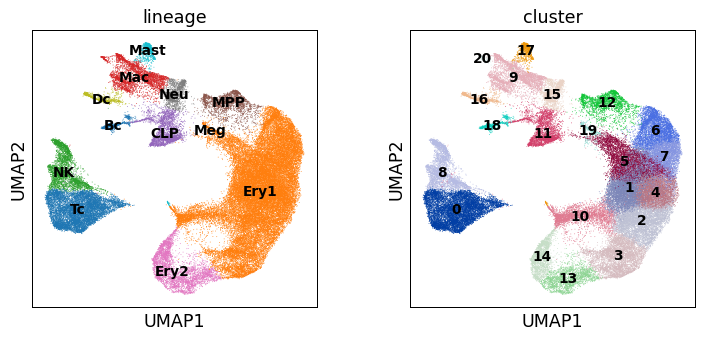

In [ ]:
sc.pl.umap(ad2, color=['lineage', 'cluster'], legend_loc='on data', legend_fontsize=11)

#### Figure 1a

In [ ]:
from matplotlib import cm
print(cm.tab10.colors)

((0.12156862745098039, 0.4666666666666667, 0.7058823529411765), (1.0, 0.4980392156862745, 0.054901960784313725), (0.17254901960784313, 0.6274509803921569, 0.17254901960784313), (0.8392156862745098, 0.15294117647058825, 0.1568627450980392), (0.5803921568627451, 0.403921568627451, 0.7411764705882353), (0.5490196078431373, 0.33725490196078434, 0.29411764705882354), (0.8901960784313725, 0.4666666666666667, 0.7607843137254902), (0.4980392156862745, 0.4980392156862745, 0.4980392156862745), (0.7372549019607844, 0.7411764705882353, 0.13333333333333333), (0.09019607843137255, 0.7450980392156863, 0.8117647058823529))


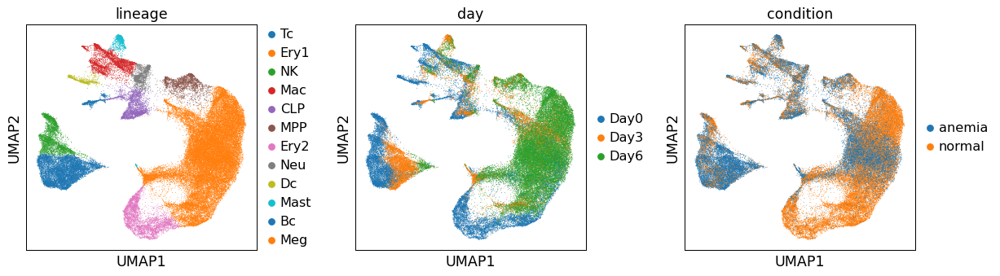

In [ ]:
## Plot these celltypes on UMAP. 
#scv.pl.umap(ad2, color=['lineage', 'day', 'condition'], wspace=0.3)
sc.pl.umap(ad2, color=['lineage', 'day', 'condition'], wspace=0.3, palette=cm.tab10.colors)

In [ ]:
## Marker genes for each lineage. 
grouporder = ['MPP', 'Neu', 'Bc', 'Tc', 'NK', 'Mac', 'CLP', 'Dc', 'Mast', 'Ery1', 'Ery2'] 
grouporder = ['Ery1', 'Ery2', 'NK', 'Tc', 'Bc', 'Dc', 'Meg', 'CLP', 'Neu', 'MPP', 'Mac', 'Mast'] 
sc.tl.rank_genes_groups(ad2, groupby='lineage', groups=grouporder, use_raw=False) 

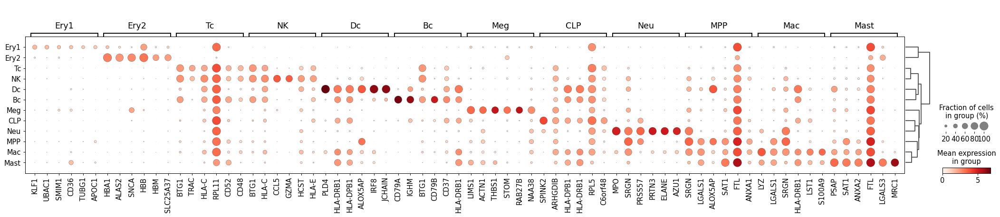

In [ ]:
## Show marker genes.
sc.tl.dendrogram(ad2, groupby='lineage')

## Reorder?  No, order by dendrogram.  
_ = sc.pl.rank_genes_groups_dotplot(ad2, n_genes=6, dendrogram=True, smallest_dot=0, dot_max=1, groups=grouporder, categories_order=grouporder, expression_cutoff=2)  ## vmax=1

In [ ]:
## Nice atlas. 
#scv.pl.umap(ad2, color=['lineage' ], wspace=0.3, dpi=120, legend_fontsize=10, legend_loc='on data', frameon=True)

In [ ]:
## Plot for paper.  
#scv.pl.umap(ad2, color=['lineage', ], dpi=120, legend_fontsize=10, legend_loc='on right', frameon=True, groups=grouporder)
#scv.pl.umap(ad2, color=['condition'], dpi=120, legend_fontsize=10, legend_loc='on right', frameon=True)

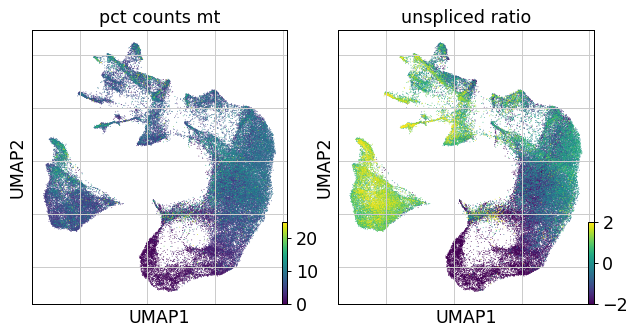

In [ ]:
## Traj B has high mito and unspliced. 
scv.pl.umap(ad2, color=['pct_counts_mt', 'unspliced_ratio'], legend_fontsize=10, legend_loc='on right', frameon=True)

#### Figure 1c

In [ ]:
## Function to rotate the color pallete so my plots are consistent.  
def rotate_colors(i):
  from matplotlib import cm
  c = cm.tab10.colors
  return (c + c)[i:(i+len(c))]

rotate_colors(3)

((0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529),
 (0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313))

In [ ]:
## UMAPs of Day 0, 3, 6 samples individually.   
## This is a bit complicated.  We create one figure to hold three plots/axes.
## Create a temporary obs column with celltypes for each day. Other days called null.
## Need to adjust color palette to match previous.  
if False:
  fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(3*4+2, 4))

  ## Color order deduced to be B,CLP,DC,Ery1,Ery2,MPP?,Mac,NK,Neu,T.  Reorder colors. 
  c = cm.tab10.colors
  mycolors = (c[9], c[3], c[8], c[0], c[2], c[6], c[5], c[4], c[7], c[1])

  ad2.obs['Day0'] = np.where(ad2.obs['day']=="Day0", ad2.obs['lineage'], "null")
  celltypes = [x for x in list(set(ad2.obs['Day0'])) if x!="null"]
  axes[0] = sc.pl.umap(ad2, color=['Day0'], groups=grouporder, ax=axes[0], show=False, palette=mycolors)
  ad2.obs.drop('Day0', axis=1, inplace=True)

  ad2.obs['Day3'] = np.where(ad2.obs['day']=="Day3", ad2.obs['lineage'], "null")
  celltypes = [x for x in list(set(ad2.obs['Day3'])) if x!="null"]
  axes[1] = sc.pl.umap(ad2, color=['Day3'], groups=grouporder, ax=axes[1], show=False, palette=mycolors)
  ad2.obs.drop('Day3', axis=1, inplace=True)

  ad2.obs['Day6'] = np.where(ad2.obs['day']=="Day6", ad2.obs['lineage'], "null")
  celltypes = [x for x in list(set(ad2.obs['Day6'])) if x!="null"]
  axes[2] = sc.pl.umap(ad2, color=['Day6'], groups=grouporder, ax=axes[2], show=False, palette=mycolors)
  ad2.obs.drop('Day6', axis=1, inplace=True)

  fig.tight_layout()
gc.collect()

0

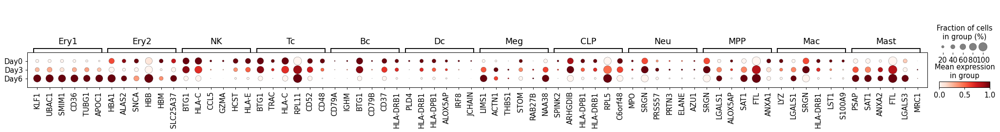

In [ ]:
## Dotplots can reflect cell numbers. 
#groups = ['MPP', 'Neu', 'B', 'T', 'NK', 'Mac', 'CLP', 'DC', 'Ery1', 'Ery2']
#_ = sc.pl.rank_genes_groups_dotplot(ad2, groupby='day', groups=grouporder, n_genes=6, dendrogram=False, dot_min=0, dot_max=1, standard_scale='group')
_ = sc.pl.rank_genes_groups_dotplot(ad2, groupby='day', groups=grouporder, n_genes=6, dendrogram=False, dot_min=0, dot_max=1, standard_scale='var')

In [ ]:
## Make a DataFrame table to help determine cell type for each cluster.
days = sorted(set(ad2.obs['day']))  ## Three days in columns. 
lineages = sorted(set(ad2.obs['lineage']))  ## Seven lineages in rows. 
countbytype = {"Lineage": lineages}  ## Data into a dictionary. 
for xd in days:
  adx = ad2[ad2.obs['day']==xd]  ## Slice data by day. 
  countbytype[xd] = [len(adx[adx.obs['lineage']==xl]) for xl in lineages] 

## Hard-code the results here, just so we don't forget. 
#print(countbytype)
countbytype = pd.DataFrame(countbytype)  ## Convert to DataFrame. 
#countybytype = {'Lineage': ['B', 'DC', 'Ery', 'Lym', 'MPP', 'Mit', 'Mye'], 'Day0': [190, 624, 6971, 4891, 1581, 226, 2049], 'Day3': [49, 19, 3821, 1564, 597, 182, 1155], 'Day6': [5, 3, 21350, 105, 185, 577, 2370]}
#countbytype = countbytype.append(dict(Lineage="TOTAL", Day0=16677, Day3=7439, Day6=24693), ignore_index=True) 	## Sum totals.
countbytype = countbytype.append(dict(Lineage="Runs", Day0=12, Day3=8, Day6=12), ignore_index=True) 	## Note Day 3 had fewer runs. 
countbytype

,Lineage,Day0,Day3,Day6
0,Bc,438,195,26
1,CLP,1782,681,170
2,Dc,719,36,4
3,Ery1,3730,5497,26938
4,Ery2,3893,112,84
5,MPP,50,532,1549
6,Mac,2285,471,613
7,Mast,7,491,258
8,Meg,82,127,196
9,NK,2467,773,33


#### Figure 1b and 1d

In [ ]:
## Redefine condition with MDS and DBA and Ctrl. 
ad2.obs['condition'] = ad2.obs['id'].str[0]
ad2.obs['condition'] = ad2.obs['condition'].replace('D', 'DBA')
ad2.obs['condition'] = ad2.obs['condition'].replace('M', 'MDS')
ad2.obs['condition'] = ad2.obs['condition'].replace('N', 'Ctrl')
set(ad2.obs['condition'])

{'Ctrl', 'DBA', 'MDS'}

In [ ]:
## Choose order to list lineages in legend. 
groups = list(set(ad2.obs['lineage']))
print(groups)
groups=['Ery1', 'Ery2', 'Mast', 'MPP', 'CLP', 'Neu', 'Bc', 'Tc', 'NK', 'Dc', 'Mac', 'Meg']

['NK', 'Tc', 'CLP', 'MPP', 'Mast', 'Neu', 'Mac', 'Ery2', 'Dc', 'Bc', 'Meg', 'Ery1']


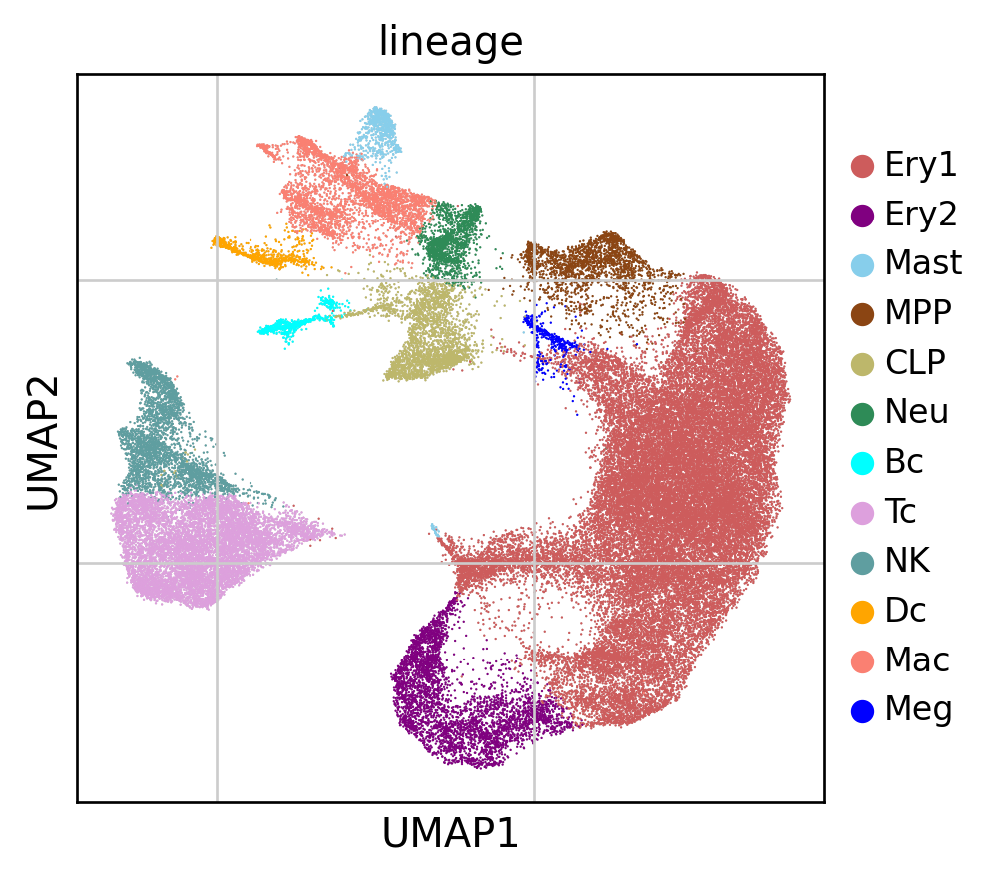

In [ ]:
## View all cells annotated from the current AnnData.  
colors = dict(Ery1="indianred", Ery2="purple", Mast="skyblue", MPP="saddlebrown", CLP="darkkhaki", 
  Neu="seagreen", Bc="aqua", Tc="plum", NK="cadetblue", Dc="orange", Mac="salmon", Meg="blue", null="gainsboro") 
palette = [colors[x] for x in list(ad2.obs['lineage'].cat.categories)]
scv.pl.umap(ad2, color=['lineage'], groups=groups, dpi=120, legend_loc='on right', legend_fontsize=10, frameon=True, palette=palette)
#sc.pl.umap(ad2, color=['lineage'], groups=groups, legend_loc='on right', legend_fontsize=10)

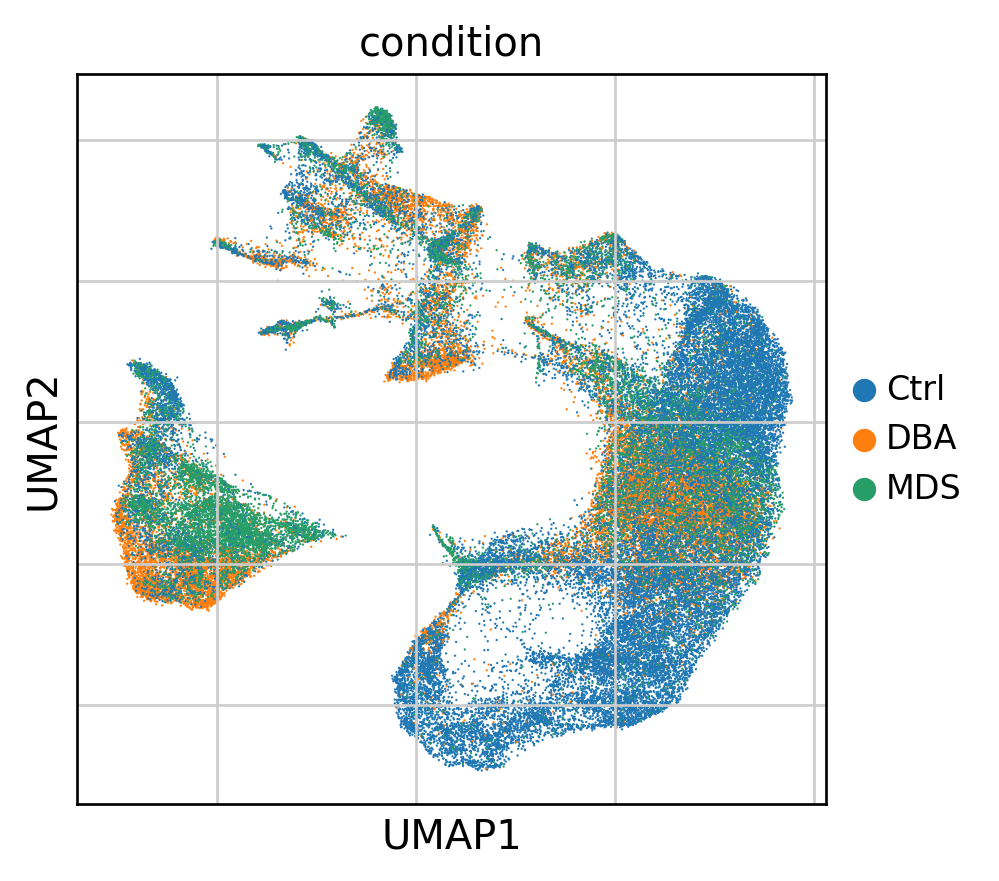

In [ ]:
## Show Condition.
scv.pl.umap(ad2, color=['condition'], dpi=120, legend_loc='on right', legend_fontsize=10, frameon=True)

27725

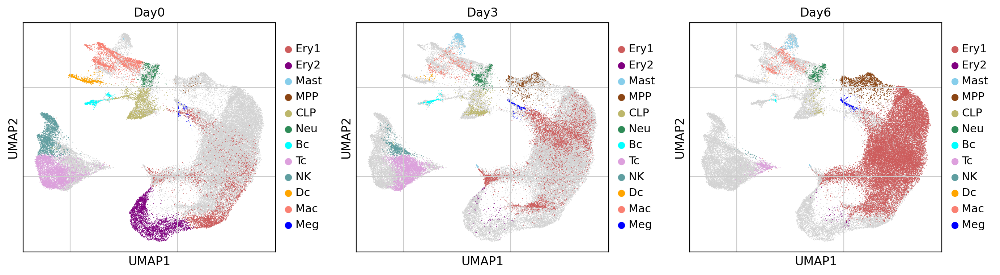

In [ ]:
## UMAPs of Day 0, 3, 6 samples individually.   
## This is a bit complicated.  We create one figure to hold three plots/axes.
## Create a temporary obs column with celltypes for each day. Other days called null.
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(3*4+2, 4))

ad2.obs['Day0'] = np.where(ad2.obs['day']=="Day0", ad2.obs['lineage'], "null")
ad2.obs['Day0'] = ad2.obs['Day0'].astype('category')
palette = [colors[x] for x in list(ad2.obs['Day0'].cat.categories)]
axes[0] = scv.pl.umap(ad2, color=['Day0'], groups=groups, palette=palette, ax=axes[0], legend_loc='on right', show=False)
ad2.obs.drop('Day0', axis=1, inplace=True)

ad2.obs['Day3'] = np.where(ad2.obs['day']=="Day3", ad2.obs['lineage'], "null")
ad2.obs['Day3'] = ad2.obs['Day3'].astype('category')
palette = [colors[x] for x in list(ad2.obs['Day3'].cat.categories)]
axes[1] = scv.pl.umap(ad2, color=['Day3'], groups=groups, palette=palette, ax=axes[1], legend_loc='on right', show=False)
ad2.obs.drop('Day3', axis=1, inplace=True)

ad2.obs['Day6'] = np.where(ad2.obs['day']=="Day6", ad2.obs['lineage'], "null")
ad2.obs['Day6'] = ad2.obs['Day6'].astype('category')
palette = [colors[x] for x in list(ad2.obs['Day6'].cat.categories)]
axes[2] = scv.pl.umap(ad2, color=['Day6'], groups=groups, palette=palette, ax=axes[2], legend_loc='on right', show=False)
ad2.obs.drop('Day6', axis=1, inplace=True)

fig.tight_layout()
gc.collect()

#### Optional copy of annotated data.

In [ ]:
## Convert booleans to strings before saving.
ad2.obs['trajectoryb'] = ad2.obs['trajectoryb'].astype('str')
ad2.obs['trajectoryb'] = ad2.obs['trajectoryb'].astype('category')
ad2.obs['hap'] = ad2.obs['hap'].astype('str')
ad2.obs['hap'] = ad2.obs['hap'].astype('category')

In [ ]:
## Save to virtual machine temporary disk.  
ad2.write("step03_lineage_211012.h5ad", compression='gzip')  ## 988 MB file.
!ls -lh "step03_lineage_211012.h5ad"

-rw-r--r-- 1 root root 988M Oct 13 07:01 step03_lineage_211012.h5ad


### 4) Calculate Pseudotime

In [ ]:
%%bash
## Annotated Filtered Scaled Log Norm data. 
MYURL="https://filedn.com/lqG7xVB6iHlJD0QAnosrwfH/data/anemia2021/"
MYFILE="step03_lineage_211012.h5ad"
[ -e ${MYFILE} ] || wget -q "${MYURL}${MYFILE}"
ls -lh ${MYFILE}

In [ ]:
## Reload, if necessary. 
#ad2 = sc.read_h5ad("step03_lineage_211012.h5ad")
#ad2

#### Erythroid lineage 1

##### Select cells

In [ ]:
## Choose erythroid lineage. 
adEry = ad2
adEry = adEry[(adEry.obs['lineage']=='MPP') | (adEry.obs['lineage']=='Ery1') | (adEry.obs['lineage']=='Ery1')]
adEry.shape

(38296, 7545)

In [ ]:
## Recluster to help remove more non-erythroid, like Megakaryocyte. 
sc.tl.leiden(adEry, resolution=0.3, restrict_to=('cluster',['12']), key_added='recluster12') 
sc.tl.leiden(adEry, resolution=1, restrict_to=('cluster',['5']), key_added='recluster5')
sc.pl.umap(adEry, color=['Meg', 'KIT', 'recluster12', 'recluster5'], legend_loc='right margin', legend_fontsize=10, color_map='viridis') 

In [ ]:
## Remove non-erythroid.
keep = (adEry.obs['recluster12']!='12,0') & (adEry.obs['recluster12']!='12,1') & (adEry.obs['recluster12']!='12,3') 
keep = keep & (adEry.obs['recluster5']!='5,6')
adEry = adEry[keep]
adEry.shape

(36388, 7545)

In [ ]:
gc.collect()

88

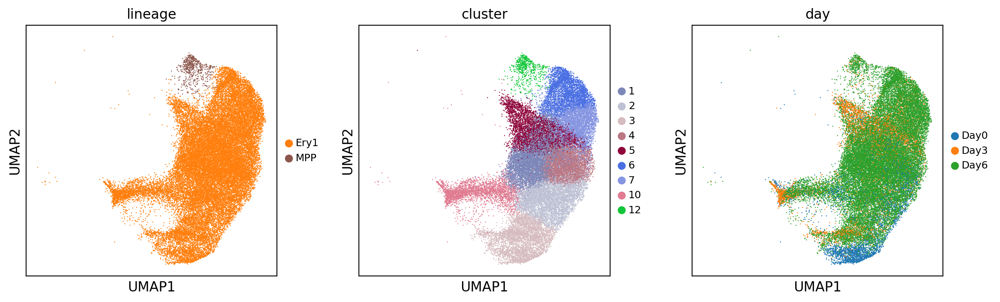

In [ ]:
## Review changes.
sc.pl.umap(adEry, color=['lineage', 'cluster', 'day'], legend_loc='right margin', legend_fontsize=9, color_map='viridis') 

In [ ]:
## Get 2000 most highly-variable genes. 
scv.pp.filter_genes_dispersion(adEry, flavor='cell_ranger', log=False, n_top_genes=2000, subset=False) 

## Shrink adEry to key or highly-variable genes.
#adEry[:,'SLC4A1'].var['keygene'] = True  ## This could've been added earlier.   
#adEry[:,'HBD'].var['keygene'] = True  ## This could've been added earlier.  
adEry[:,'KIT'].var['keygene'] = True  ## This could've been added earlier. 
adEry = adEry[ :, (adEry.var['highly_variable'] | adEry.var['keygene']) ]

Trying to set attribute `.var` of view, copying.
Trying to set attribute `.var` of view, copying.


Extracted 2000 highly variable genes.


In [ ]:
adEry = adEry.copy()
adEry

AnnData object with n_obs × n_vars = 36388 × 2032
    obs: 'day', 'barcode', 'id', 'batch', 'doublet_score', 'predicted_doublet', 'prob', 'trajectoryb', 'hap', 'tsb-CD70', 'tsb-CD36', 'tsb-CD71', 'tsb-CD3', 'tsb-CD235a', 'tsb-CD14', 'tsb-CD117', 'tsb-CD11b', 'tsb-CD4', 'tsb-CD8', 'tsb-CD11c', 'tsb-CD16', 'tsb-CD19', 'tsb-CD45', 'tsb-CD56', 'exp', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'counts', 'Tcell', 'Mac', 'Bcell', 'DC', 'NK', 'Neu', 'Ery', 'Meg', 'Mast', 'MPP', 'CLP', 'Mito', 'Hb', 'S_score', 'G2M_score', 'phase', 'condition', 'kit', 'day_exp', 'leiden', 'louvain', 'n_spliced', 'n_unspliced', 'unspliced_ratio', 'cluster', 'lineage', 'sample', 'tsb-sum', 'tsb-entropy', 'recluster5', 'recluster12'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispe

In [ ]:
gc.collect()

88

##### RNA Velocity

In [ ]:
## Caclulate moments.  Takes 2 min. 
scv.pp.moments(adEry, n_pcs=30, n_neighbors=30)

Normalized count data: spliced, unspliced.
computing neighbors
    finished (0:00:33) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:05) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [ ]:
## Takes 60min.  Skip it and use stochastic model instead. 
#scv.tl.recover_dynamics(adEry)

In [ ]:
## Calculate RNA velocity and graph.  Graph takes 2 min. 
scv.tl.velocity(adEry, mode='dynamical')
scv.tl.velocity_graph(adEry, approx=True)
scv.tl.velocity_embedding(adEry)

computing velocities
    finished (0:00:09) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:20) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:11) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


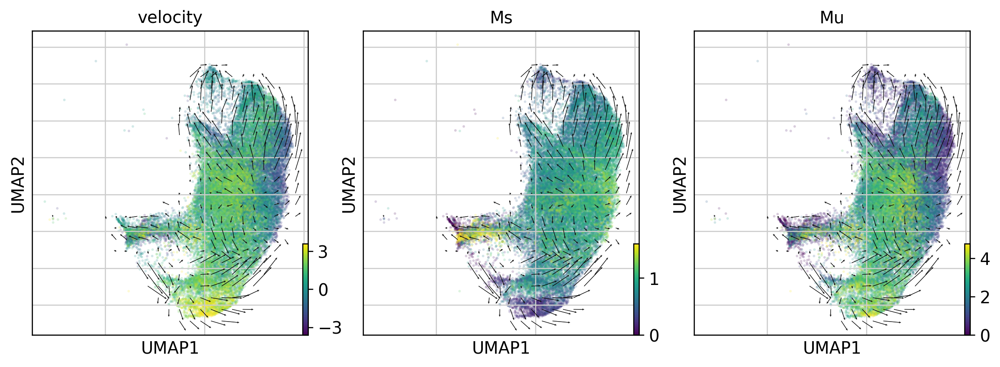

In [ ]:
## Velocity grid looks pretty, but arrows are reverse of expected.  
## Options: TFRC/CD71, GYPA1, GATA1, KLF1, ZFPM1/FOG1, 
#scv.pl.velocity_embedding_stream(adEry, color='TFRC', layer=['velocity', 'spliced', 'unspliced'], dpi=160)
scv.pl.velocity_embedding_grid(adEry, color='GATA1', layer=['velocity', 'Ms', 'Mu'], arrow_length=4, dpi=120, density=0.5)

In [ ]:
print("Size of adEry in MB:", int(sys.getsizeof(adEry) / 1024 / 1024))

In [ ]:
## Convert dense layers to sparse. 
from scipy import sparse
adEry.layers['Ms'] = sparse.csr_matrix(adEry.layers['Ms'])
adEry.layers['Mu'] = sparse.csr_matrix(adEry.layers['Mu'])
adEry.layers['velocity'] = sparse.csr_matrix(adEry.layers['velocity'])
adEry.layers['variance_velocity'] = sparse.csr_matrix(adEry.layers['variance_velocity'])

In [ ]:
print("Size of adEry in MB:", int(sys.getsizeof(adEry) / 1024 / 1024))

Size of adEry in MB: 1460


#####  Pseudotime 0-1

In [ ]:
## Calculate neighbors for use by diffmap.  
scv.pp.pca(adEry, svd_solver='arpack', use_highly_variable=False)  
bbknn.bbknn(adEry, batch_key='day_exp', n_pcs=30)

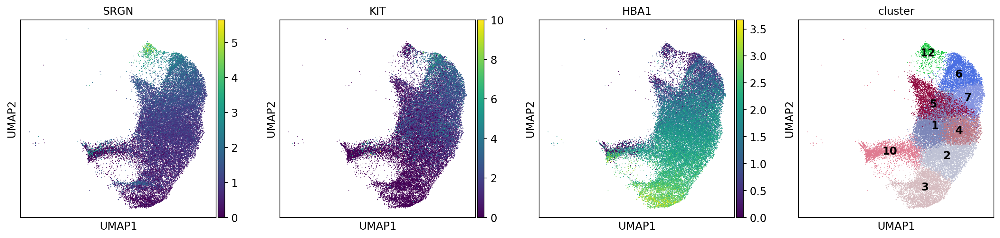

In [ ]:
## How to find root cells for pseudotime. 
sc.pl.umap(adEry, color=['SRGN', 'KIT', 'HBA1', 'cluster'], layer='X', legend_loc='on data')  ## Serglycin might be an HSC marker.

M2N6N7_8k_Day6:AACTTCTGTGGAATGCx-E5-E5
M2N6N7_8k_Day0:ATCGTAGAGTAAGCATx-E5-E5
D1N4_Day6:GTTCTCGCAAGGTGTGx-E3-E3
D1N4_Day0:TACGGGCGTACGCACCx-E3-E3
N5M1_Day6:GAGAAATGTGCTGCACx-E4-E4
N5M1_Day0:TTCGATTCATCAGTGTx-E4-E4
180703_Day6_N3:AGCATACAGACAGAGAx-E2-E2
180629_Day0_N3:GGGCACTTCAGGTTCAx-E2-E2
171004_Day6_D1_both:GCTCCTAGTGATGATAx-E1-E1
171004_Day0_D2_both:GCTTCCAAGTATCGAAx-E1-E1


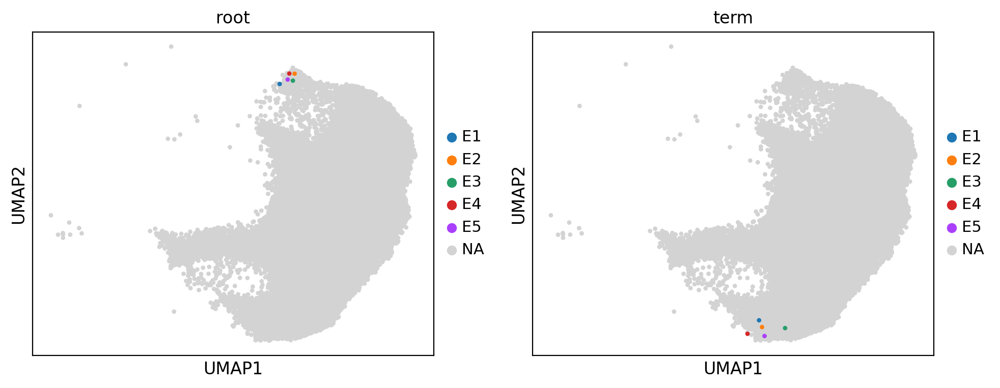

In [ ]:
## Root markers are high in KIT & SRGN.  Term are high in HBA1, low in n_counts. 

## Initialize new root and term fields, all with 'False'.
adEry.obs['root'] = np.full(len(adEry), 'False')  
adEry.obs['term'] = np.full(len(adEry), 'False')  
exps = list(set(adEry.obs['exp']))

for exp in exps:
  ## Find root.  High KIT in MPP. 
  #adx = adEry[(adEry.obs['exp']==exp) & (adEry.obs['lineage']=='MPP')]
  adx = adEry[(adEry.obs['exp']==exp) & (adEry.obs['cluster']=='12')]
  x = adx.obs_vector('SRGN', layer='X')  ## Or layer Ms
  iroot = int(np.where(x==np.max(x))[0][0])  ## In subset.
  iroot = np.where(adEry.obs.index==adx.obs_names[iroot])[0][0]  ## In superset.
  adEry.obs['root'].iloc[iroot] = exp
  print(adEry.obs_names[iroot])
  ## Find terminus.  High HBA1.  
  #adx = adEry[(adEry.obs['exp']==exp) & (adEry.obs['lineage']=='Ery2')]
  adx = adEry[(adEry.obs['exp']==exp) & (adEry.obs['cluster']=='3')]
  x = adx.obs_vector('HBA1', layer='X')  ## Or layer Ms
  iterm = int(np.where(x==np.max(x))[0][0])  ## In subset.
  iterm = np.where(adEry.obs.index==adx.obs_names[iterm])[0][0]  ## In superset.
  adEry.obs['term'].iloc[iterm] = exp
  print(adEry.obs_names[iterm])

adEry.obs['root'] = adEry.obs['root'].astype('category')
adEry.obs['term'] = adEry.obs['term'].astype('category')

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(2*4+1, 4))
axes[0] = sc.pl.umap(adEry, color=['root'], groups=exps, ax=axes[0], size=40, show=False)
axes[1] = sc.pl.umap(adEry, color=['term'], groups=exps, ax=axes[1], size=40, show=False)
fig.tight_layout()

In [ ]:
gc.collect()

88

In [ ]:
## Diffusion map. 
scv.tl.diffmap(adEry)

In [ ]:
## Specify root and terminus.
iroot = int(np.where(adEry.obs['root']=='E2')[0][0])
sroot = adEry.obs_names[iroot]
print("Root cell", iroot, "---", sroot)
adEry.uns['iroot'] = iroot

iterm = int(np.where(adEry.obs['term']=='E4')[0][0])
sterm = adEry.obs_names[iterm]
print("Terminal cell", iterm, "---", sterm)
adEry.uns['iterm'] = iterm

Root cell 13618 --- 180703_Day6_N3:AGCATACAGACAGAGAx-E2-E2
Terminal cell 21760 --- N5M1_Day0:TTCGATTCATCAGTGTx-E4-E4


In [ ]:
## Clear out old pseudotime estimates. 
#adEry.obs.drop(columns=['dpt','dpt_pseudotime','vpt','velocity_pseudotime'], inplace=True)

In [ ]:
## Diffusion pseudotime.  Requires a root, but does not use terminus.  Takes 65 sec. 
scv.tl.dpt(adEry, n_dcs=10, n_branchings=1)  ## Crashes with branching. 
adEry.obs['dpt'] = np.nan_to_num(adEry.obs['dpt_pseudotime'], nan=0.0)

In [ ]:
## Flip DiffMap, optional. 
adEry.obsm['X_diffmap'][:,1] = -adEry.obsm['X_diffmap'][:,1]  ## DC1.
#adEry.obsm['X_diffmap'][:,2] = -adEry.obsm['X_diffmap'][:,2]  ## DC2. 
#adEry.obsm['X_diffmap'][:,3] = -adEry.obsm['X_diffmap'][:,3]  ## DC3. 

In [ ]:
adEry

AnnData object with n_obs × n_vars = 36388 × 2032
    obs: 'day', 'barcode', 'id', 'batch', 'doublet_score', 'predicted_doublet', 'prob', 'trajectoryb', 'hap', 'tsb-CD70', 'tsb-CD36', 'tsb-CD71', 'tsb-CD3', 'tsb-CD235a', 'tsb-CD14', 'tsb-CD117', 'tsb-CD11b', 'tsb-CD4', 'tsb-CD8', 'tsb-CD11c', 'tsb-CD16', 'tsb-CD19', 'tsb-CD45', 'tsb-CD56', 'exp', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'counts', 'Tcell', 'Mac', 'Bcell', 'DC', 'NK', 'Neu', 'Ery', 'Meg', 'Mast', 'MPP', 'CLP', 'Mito', 'Hb', 'S_score', 'G2M_score', 'phase', 'condition', 'kit', 'day_exp', 'leiden', 'louvain', 'n_spliced', 'n_unspliced', 'unspliced_ratio', 'cluster', 'lineage', 'sample', 'tsb-sum', 'tsb-entropy', 'recluster5', 'recluster12', 'n_counts', 'velocity_self_transition', 'root', 'term', 'dpt_pseudotime', 'dpt_groups', 'dpt_order', 'dpt_order_indices', 'dpt'
    var: 'Accession', 'Chromosome', 'End', 'Start'

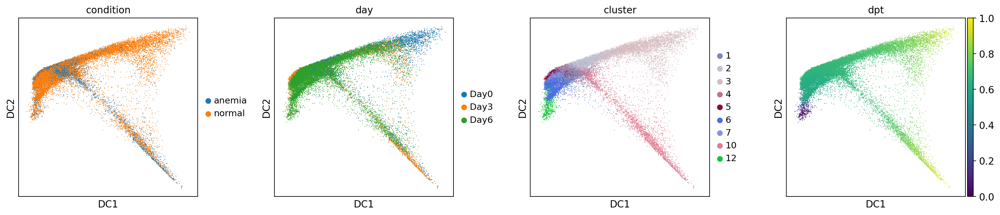

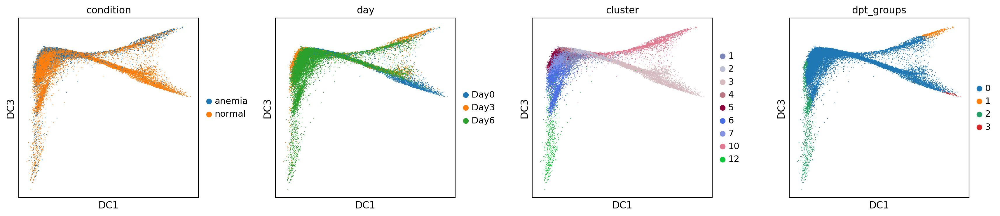

In [ ]:
## Nice diffusion maps.  But branching is not very sensitive or useful. 
sc.pl.diffmap(adEry, color=['condition', 'day', 'cluster', 'dpt'], components='1,2', wspace=0.3)
sc.pl.diffmap(adEry, color=['condition', 'day', 'cluster', 'dpt_groups'], components='1,3', wspace=0.3)
#sc.pl.diffmap(adEry, color=['dpt', 'dpt_groups'], components='3,2', wspace=0.3)

In [ ]:
## Velocity Pseudotime
scv.tl.velocity_pseudotime(adEry, root_key=iroot, end_key=iterm, use_velocity_graph=False, n_dcs=3)  ## Default is n_dcs=1010
adEry.obs['vpt'] = np.nan_to_num(adEry.obs['velocity_pseudotime'], nan=0.0)

In [ ]:
#sc.settings.set_figure_params(scanpy=True, dpi=90)

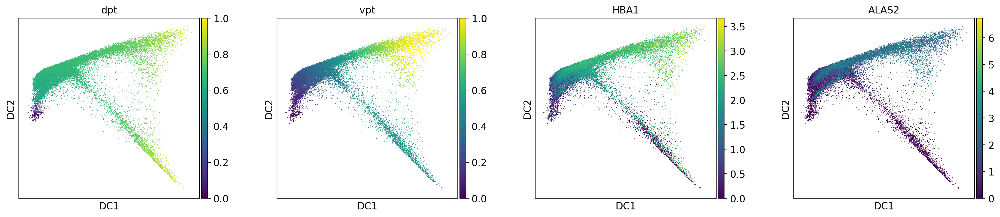

In [ ]:
sc.pl.diffmap(adEry, color=['dpt', 'vpt', 'HBA1', 'ALAS2'], components='1,2', wspace=0.3)

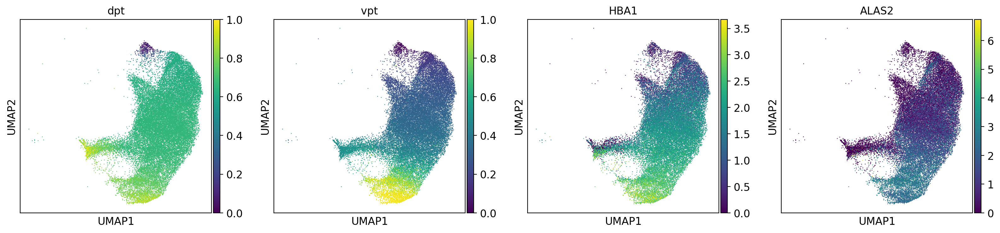

In [ ]:
sc.pl.umap(adEry, color=['dpt', 'vpt', 'HBA1', 'ALAS2'])

#### Erythroid lineage 2

##### Select cells

In [ ]:
## Choose erythroid lineage. 
adEry2 = ad2
adEry2 = adEry2[adEry2.obs['lineage']=='Ery2']
adEry2.shape

(4089, 7545)

In [ ]:
adEry2

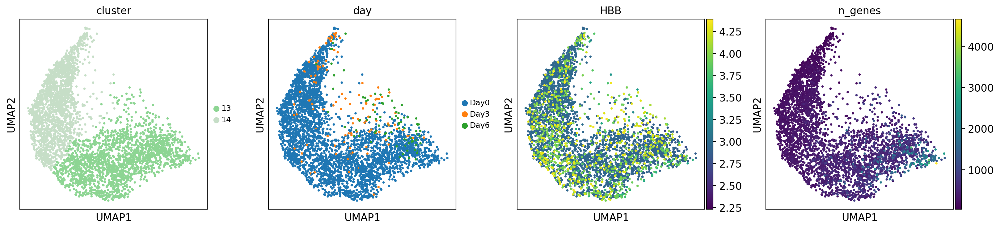

In [ ]:
## Review changes.
sc.pl.umap(adEry2, color=['cluster', 'day', 'HBB', 'n_genes'], legend_loc='right margin', legend_fontsize=9, layer='X1') 

In [ ]:
## Recall the most highly-variable genes from earlier. 
adEry2 = adEry2[ :, (ad2.var['highly_variable'] | ad2.var['keygene']) ]
adEry2 = adEry2.copy()
adEry2

AnnData object with n_obs × n_vars = 4089 × 2040
    obs: 'day', 'barcode', 'id', 'batch', 'doublet_score', 'predicted_doublet', 'prob', 'trajectoryb', 'hap', 'tsb-CD70', 'tsb-CD36', 'tsb-CD71', 'tsb-CD3', 'tsb-CD235a', 'tsb-CD14', 'tsb-CD117', 'tsb-CD11b', 'tsb-CD4', 'tsb-CD8', 'tsb-CD11c', 'tsb-CD16', 'tsb-CD19', 'tsb-CD45', 'tsb-CD56', 'exp', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'counts', 'Tcell', 'Mac', 'Bcell', 'DC', 'NK', 'Neu', 'Ery', 'Meg', 'Mast', 'MPP', 'CLP', 'Mito', 'Hb', 'S_score', 'G2M_score', 'phase', 'condition', 'kit', 'day_exp', 'leiden', 'louvain', 'n_spliced', 'n_unspliced', 'unspliced_ratio', 'cluster', 'lineage', 'sample', 'tsb-sum', 'tsb-entropy'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', '

In [ ]:
gc.collect()

88

##### RNA Velocity

In [ ]:
## Caclulate moments. 
scv.pp.moments(adEry2, n_pcs=30, n_neighbors=30)

Normalized count data: spliced, unspliced.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [ ]:
## Takes 60min.  Skip it and use stochastic model instead. 
#scv.tl.recover_dynamics(adEry)

In [ ]:
## Calculate RNA velocity and graph. 
scv.tl.velocity(adEry2, mode='dynamical')
scv.tl.velocity_graph(adEry2, approx=True)
scv.tl.velocity_embedding(adEry2)

computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


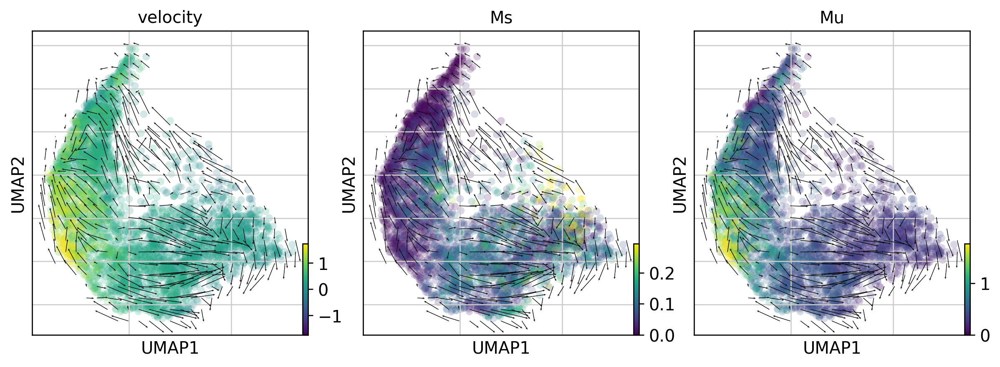

In [ ]:
## Velocity grid looks pretty, but arrows are reverse of expected.  
## Options: TFRC/CD71, GYPA1, GATA1, KLF1, ZFPM1/FOG1, 
#scv.pl.velocity_embedding_stream(adEry2, color='TFRC', layer=['velocity', 'spliced', 'unspliced'], dpi=160)
scv.pl.velocity_embedding_grid(adEry2, color='GATA1', layer=['velocity', 'Ms', 'Mu'], arrow_length=4, dpi=120, density=0.5)

In [ ]:
print("Size of adEry in MB:", int(sys.getsizeof(adEry2) / 1024 / 1024))

Size of adEry in MB: 152


In [ ]:
## Convert dense layers to sparse. 
from scipy import sparse
adEry2.layers['Ms'] = sparse.csr_matrix(adEry2.layers['Ms'])
adEry2.layers['Mu'] = sparse.csr_matrix(adEry2.layers['Mu'])
adEry2.layers['velocity'] = sparse.csr_matrix(adEry2.layers['velocity'])
adEry2.layers['variance_velocity'] = sparse.csr_matrix(adEry2.layers['variance_velocity'])

In [ ]:
print("Size of adEry in MB:", int(sys.getsizeof(adEry2) / 1024 / 1024))

Size of adEry in MB: 55


In [ ]:
gc.collect()

88

#####  Pseudotime 1-2

In [ ]:
## Optional: switch to unscaled values. 
#adEry.X = adEry.layers['X0']
#adEry.X = adEry.layers['Ms']

In [ ]:
## Calculate neighbors for use by diffmap.  
scv.pp.pca(adEry2, svd_solver='arpack', use_highly_variable=False)  
bbknn.bbknn(adEry2, batch_key='day_exp', n_pcs=30)

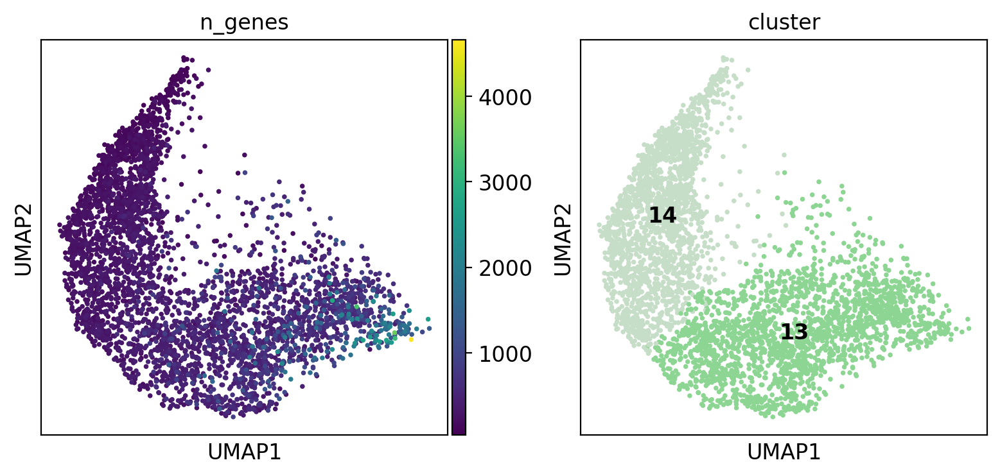

In [ ]:
## How to find root cells for pseudotime. 
sc.pl.umap(adEry2, color=['n_genes', 'cluster'], legend_loc='on data')  

M2N6N7_8k_Day0:CTCTCAGCATCGCTAAx-E5-E5
M2N6N7_8k_Day0:GCATTAGAGAGGACTCx-E5-E5
D1N4_Day0:GCTCCTACAAGCGTAGx-E3-E3
D1N4_Day0:GTATTCTCACCAGGTCx-E3-E3
N5M1_Day0:TTGAGTGTCATCGTAGx-E4-E4
N5M1_Day3:CTGAGGCTCTTCACGCx-E4-E4
180629_Day0_N2:ATGTGTGTCTTGCATTx-E2-E2
180629_Day0_D2:GTCGTAAGTGTGGCTCx-E2-E2
171004_Day0_N2_both:GCGCCAAGTATCGCATx-E1-E1
171004_Day0_D2_both:GGACGTCTCTGCGTAAx-E1-E1


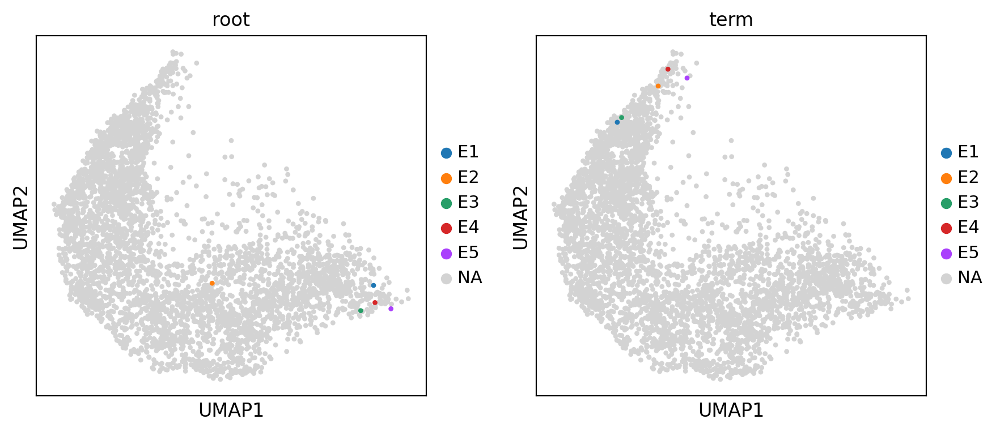

In [ ]:
## Root cell has most genes, Terminus has fewest. 

## Initialize new root and term fields, all with 'False'.
adEry2.obs['root'] = np.full(len(adEry2), 'False')  
adEry2.obs['term'] = np.full(len(adEry2), 'False')  
exps = list(set(adEry2.obs['exp']))

for exp in exps:
  ## Find root.  
  adx = adEry2[(adEry2.obs['exp']==exp) & (adEry2.obs['cluster']=='13')]
  x = adx.obs['n_genes'] 
  iroot = int(np.where(x==np.max(x))[0][0])  ## In subset.
  iroot = np.where(adEry2.obs.index==adx.obs_names[iroot])[0][0]  ## In superset.
  adEry2.obs['root'].iloc[iroot] = exp
  print(adEry2.obs_names[iroot])
  ## Find terminus.  
  adx = adEry2[(adEry2.obs['exp']==exp) & (adEry2.obs['cluster']=='14')]
  x = adx.obs['n_genes'] 
  iterm = int(np.where(x==np.min(x))[0][0])  ## In subset.
  iterm = np.where(adEry2.obs.index==adx.obs_names[iterm])[0][0]  ## In superset.
  adEry2.obs['term'].iloc[iterm] = exp
  print(adEry2.obs_names[iterm])

adEry2.obs['root'] = adEry2.obs['root'].astype('category')
adEry2.obs['term'] = adEry2.obs['term'].astype('category')

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(2*4+1, 4))
axes[0] = sc.pl.umap(adEry2, color=['root'], groups=exps, ax=axes[0], size=40, show=False)
axes[1] = sc.pl.umap(adEry2, color=['term'], groups=exps, ax=axes[1], size=40, show=False)
fig.tight_layout()

In [ ]:
gc.collect()

35017

In [ ]:
## Diffusion map. 
scv.tl.diffmap(adEry2)

In [ ]:
## Specify root and terminus.
iroot = int(np.where(adEry2.obs['root']=='E5')[0][0])
sroot = adEry2.obs_names[iroot]
print("Root cell", iroot, "---", sroot)
adEry2.uns['iroot'] = iroot

iterm = int(np.where(adEry2.obs['term']=='E5')[0][0])
sterm = adEry2.obs_names[iterm]
print("Terminal cell", iterm, "---", sterm)
adEry2.uns['iterm'] = iterm

Root cell 4048 --- M2N6N7_8k_Day0:CTCTCAGCATCGCTAAx-E5-E5
Terminal cell 4057 --- M2N6N7_8k_Day0:GCATTAGAGAGGACTCx-E5-E5


In [ ]:
## Diffusion pseudotime.  Requires a root, but does not use terminus.  Takes 65 sec. 
scv.tl.dpt(adEry2, n_dcs=10, n_branchings=0)  ## Crashes with branching. 
adEry2.obs['dpt'] = np.nan_to_num(adEry2.obs['dpt_pseudotime'], nan=0.0)

In [ ]:
## Flip DiffMap, optional. 
#adEry2.obsm['X_diffmap'][:,1] = -adEry2.obsm['X_diffmap'][:,1]  ## DC1.
#adEry2.obsm['X_diffmap'][:,2] = -adEry2.obsm['X_diffmap'][:,2]  ## DC2. 
#adEry2.obsm['X_diffmap'][:,3] = -adEry2.obsm['X_diffmap'][:,3]  ## DC3. 

In [ ]:
## Velocity Pseudotime
scv.tl.velocity_pseudotime(adEry2, root_key=iroot, end_key=iterm, use_velocity_graph=False, n_dcs=3)  ## Default is n_dcs=10
adEry2.obs['vpt'] = np.nan_to_num(adEry2.obs['velocity_pseudotime'], nan=0.0)

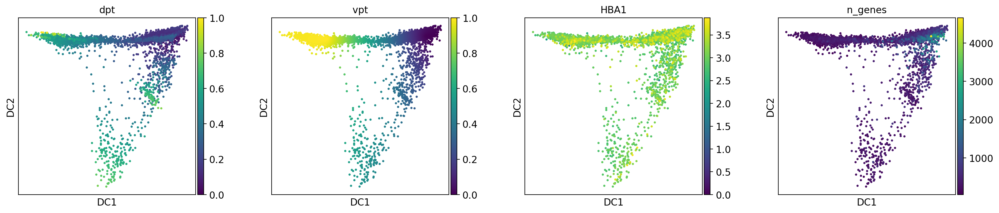

In [ ]:
sc.pl.diffmap(adEry2, color=['dpt', 'vpt', 'HBA1', 'n_genes'], components='1,2', wspace=0.3)

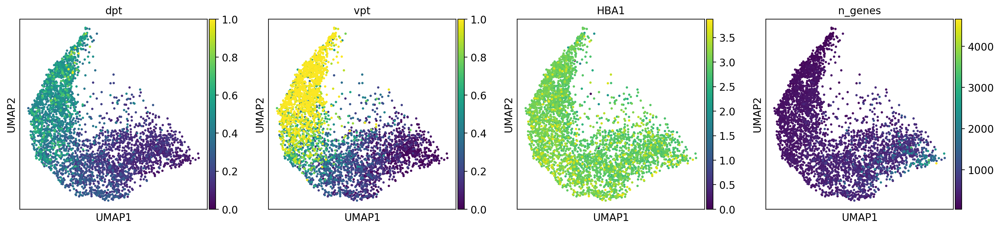

In [ ]:
sc.pl.umap(adEry2, color=['dpt', 'vpt', 'HBA1', 'n_genes'])

#### Merge and save results

Concatenate Ery1 and Ery2 (plus 1.0).  Merge with dataframe with all cells.  Save to csv. 

In [ ]:
## Ery1 dataframe. 
dfEry1 = adEry.obs[['vpt','dpt','root','term']]
dfEry1['root'] = dfEry1['root'].str.replace("E", "Ery1_E")
dfEry1['term'] = dfEry1['term'].str.replace("E", "Ery1_E")
print(len(dfEry1))

## Ery2 dataframe.  Increase pseudotime by 1.0 units. 
dfEry2 = adEry2.obs[['vpt','dpt','root','term']]
dfEry2['root'] = dfEry2['root'].str.replace("E", "Ery2_E")
dfEry2['term'] = dfEry2['term'].str.replace("E", "Ery2_E")
dfEry2['vpt'] = dfEry2['vpt'] + 1.0
dfEry2['dpt'] = dfEry2['dpt'] + 1.0
print(len(dfEry2))

## Combine
dfEry = pd.concat([dfEry1, dfEry2])
print(len(df))

36388
4089
40477


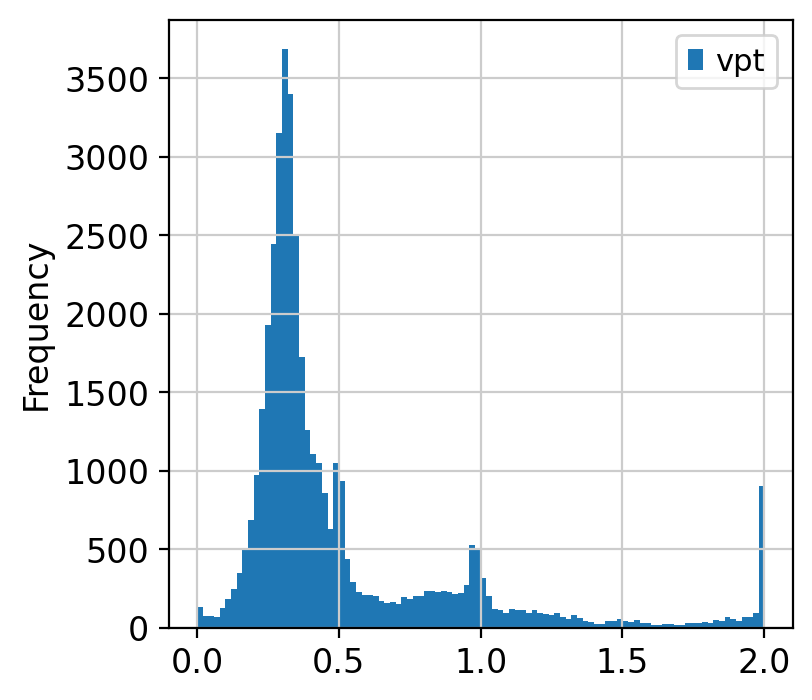

In [ ]:
_ = dfEry[['vpt']].plot.hist(bins=100)

In [ ]:
## DataFrame with all cells and tsb-sum etc.
df = ad2.obs[['tsb-sum', 'tsb-entropy']]
df = df.merge(dfEry, how='left', left_index=True, right_index=True)
df[['dpt', 'vpt']] = df[['dpt', 'vpt']].fillna(-1.0)
df[['root', 'term']] = df[['root', 'term']].fillna(False)
df = df.round(decimals=3)
df.tail(2)

,tsb-sum,tsb-entropy,vpt,dpt,root,term
CellID,,,,,,
M2N6N7_8k_Day6:TTTCGATAGCGATCGAx-E5-E5,18.947,1.534,0.207,0.636,False,False
M2N6N7_8k_Day6:TTTCAGTTCGATGCTAx-E5-E5,26.799,1.795,0.478,0.670,False,False


In [ ]:
## Save
df.to_csv("step04_pseudotime_211020.csv.gz", compression='gzip')
!ls -lh *.csv.gz 

-rw-r--r-- 1 root root 744K Oct 21 06:03 step04_pseudotime_211020.csv.gz


### 5) Define Stages

#### Use velocity pseudotime for staging

Add pseudotime data.  Calculate stage. 

In [ ]:
%%bash
## Download pseudotime file.
#wget -q "https://filedn.com/lqG7xVB6iHlJD0QAnosrwfH/data/anemia2021/step04_pseudotime_211020.csv.gz"
#gunzip "step04_pseudotime_211020.csv.gz"
#ls -lh *.csv

In [ ]:
## Load pseudotime into dataframe. 
#vptdf = pd.read_csv("step04_pseudotime_211020.csv", index_col=0)
#print("cell number:", len(vptdf))
#vptdf.tail(2)

In [ ]:
## Add pseudotime to AnnData.  
#ad2.obs = ad2.obs.merge(vptdf, how='left', left_index=True, right_index=True)
#ad2.obs.shape

In [ ]:
## Assign cells to seven stages A-G. 
## Guess:  Zero    MPP     BFUe   CFUe1   CFUe2   ProEB   BasoEB  PolyEB  OrthoEB 
## stage:  0.00    0.10    0.25   0.40    0.70    0.95    1.40    1.90    2.00  
bins, labels = [0.00, 0.10, 0.25, 0.40, 0.70, 0.95, 1.40, 1.90, 2.00], ['A','B','C1','C2','D','E','F','G']
ad2.obs['stage'] = pd.cut(ad2.obs['vpt'], bins=bins, labels=labels)

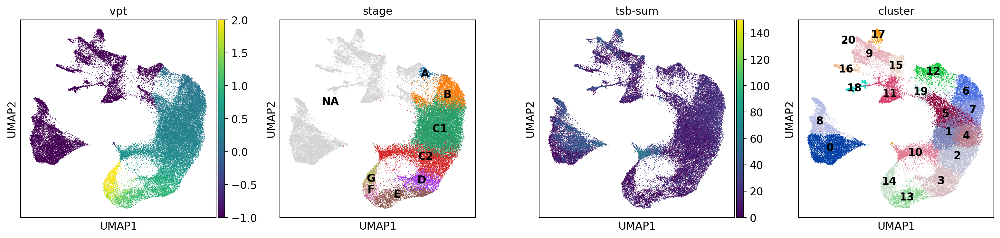

In [ ]:
## Show pseudotime
sc.pl.umap(ad2, color=['vpt', 'stage', 'tsb-sum', 'cluster'], legend_loc='on data')

Recalculate RNA Velocity (if lost)

In [ ]:
## Caclulate moments.  Takes 2 min. 
#scv.pp.moments(ad2, n_pcs=30, n_neighbors=30)

In [ ]:
## Takes 60min.  Skip it and use stochastic model instead. 
#scv.tl.recover_dynamics(ad2)

In [ ]:
## Calculate RNA velocity and graph.  Graph takes 2 min. 
#scv.tl.velocity(ad2, mode='dynamical')
#scv.tl.velocity_graph(ad2, approx=True)
#scv.tl.velocity_embedding(ad2)

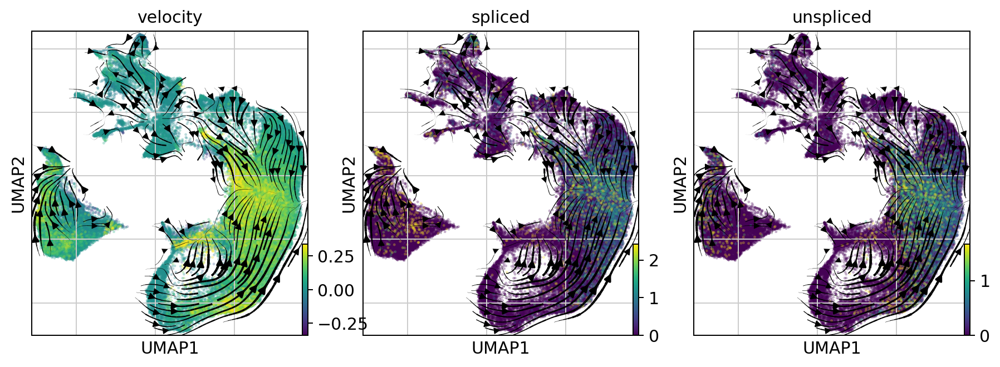

In [ ]:
## Velocity grid looks nice.  
## Options: TFRC/CD71, GYPA1, GATA1, KLF1, ZFPM1/FOG1, 
dpi = 160
dpi = 90
scv.pl.velocity_embedding_stream(ad2, color='ZFPM1', layer=['velocity', 'spliced', 'unspliced'], dpi=dpi)
#scv.pl.velocity_embedding_grid(ad2, color='GATA1', layer=['velocity', 'spliced', 'unspliced'], arrow_length=4, dpi=160, density=0.5)

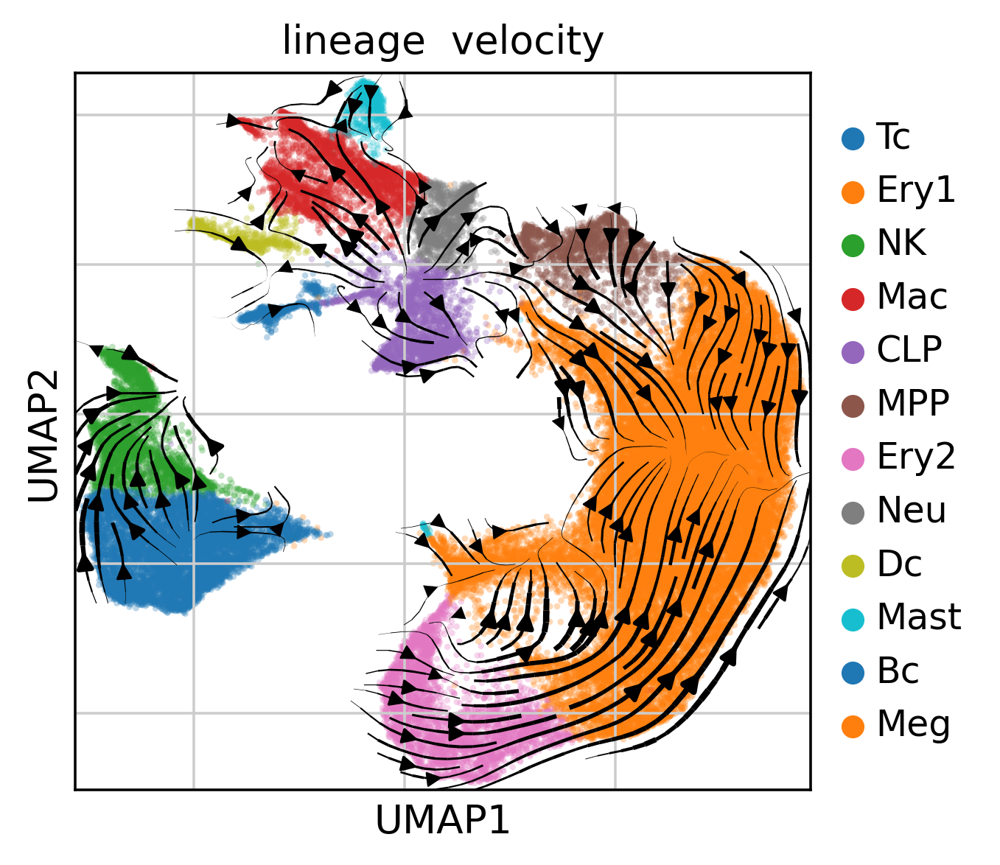

In [ ]:
scv.pl.velocity_embedding_stream(ad2, color=['lineage'], layer=['velocity'], dpi=160, legend_loc='on right')

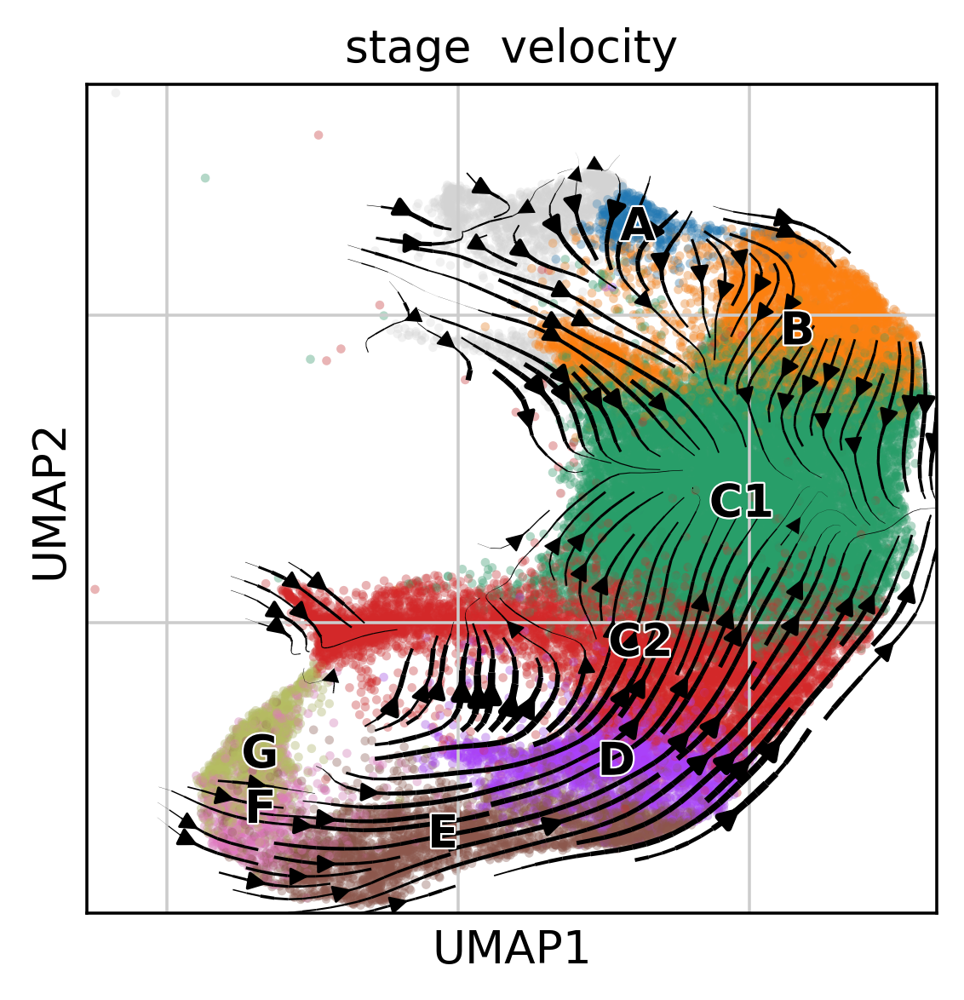

In [ ]:
## Show Erythroid, trimming off left edge of UMAP1. 
keep = (ad2.obs['lineage']=='Ery1') | (ad2.obs['lineage']=='Ery2') | (ad2.obs['lineage']=='MPP')
umap1 = ad2.obsm['X_umap'][:,0]
min = np.min(umap1)
keep = keep & (umap1 >= (min+5.6))
scv.pl.velocity_embedding_stream(ad2[keep], color=['stage'], layer=['velocity'], dpi=160, legend_loc='on data')

In [ ]:
gc.collect()

70992

In [ ]:
set(ad2.obs['id'])

{'D1', 'D2', 'M1', 'M2', 'N1', 'N2', 'N3', 'N4', 'N5', 'N6', 'N7'}

#### UMAPs of CD markerws

In [ ]:
## Focus on experiments with protein data. 
#keep = (ad2.obs['exp']=='E3') | (ad2.obs['exp']=='E4') 
keep = (ad2.obs['exp']=='E3') | (ad2.obs['exp']=='E4') | (ad2.obs['exp']=='E5')
ad2x = ad2[keep].copy()

In [ ]:
## Function to show a cell density UMAP. 
def density_plot(ad, gene='tsb-CD36', title='CD36 Protein', thr=None):
  if (thr==None): thr = np.median(ad.obs_vector(gene)) 
  ad.obs['binx'] = ['T' if (x>=thr) else 'F' for x in ad.obs_vector(gene)]
  ad.obs['binx'] = ad.obs['binx'].astype('category')
  sc.tl.embedding_density(ad, basis='umap', groupby='binx')
  sc.pl.embedding_density(ad, basis='umap', key='umap_density_binx', fg_dotsize=60, bg_dotsize=60, group='T', title=title)
  gc.collect()

Next, we'll just show UMAPs of erythroid cells for use in Figure S4. 

##### CD36

In [ ]:
keep = (ad2x.obs['lineage']=='MPP') | (ad2x.obs['lineage']=='Ery1') | (ad2x.obs['lineage']=='Ery2')
ad2Ex = ad2x[keep]

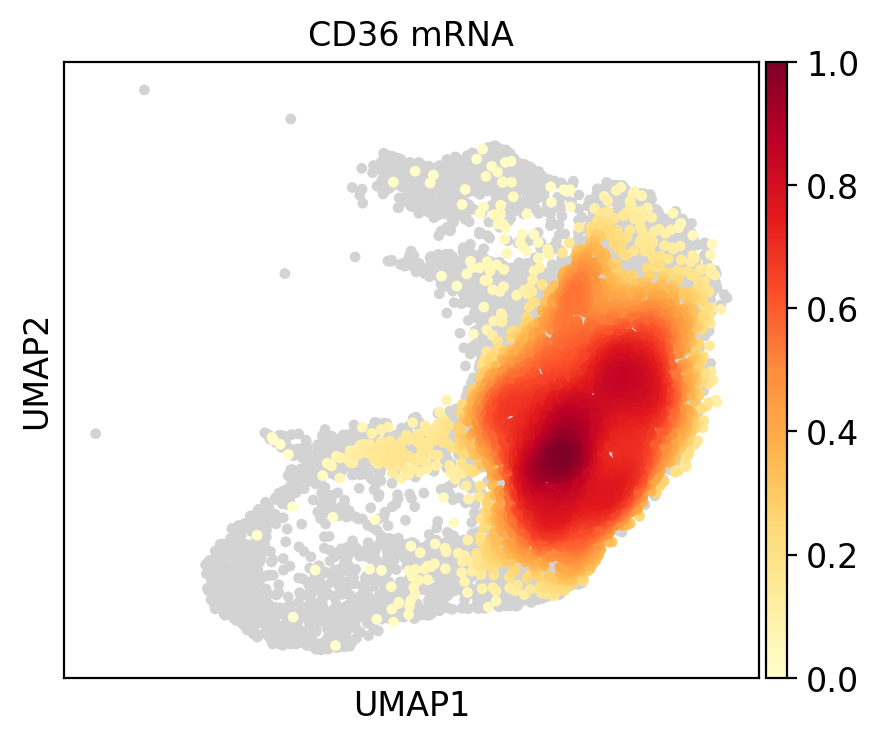

1.9928703904151917


In [ ]:
density_plot(ad2Ex, gene='CD36', title='CD36 mRNA', thr=None) 

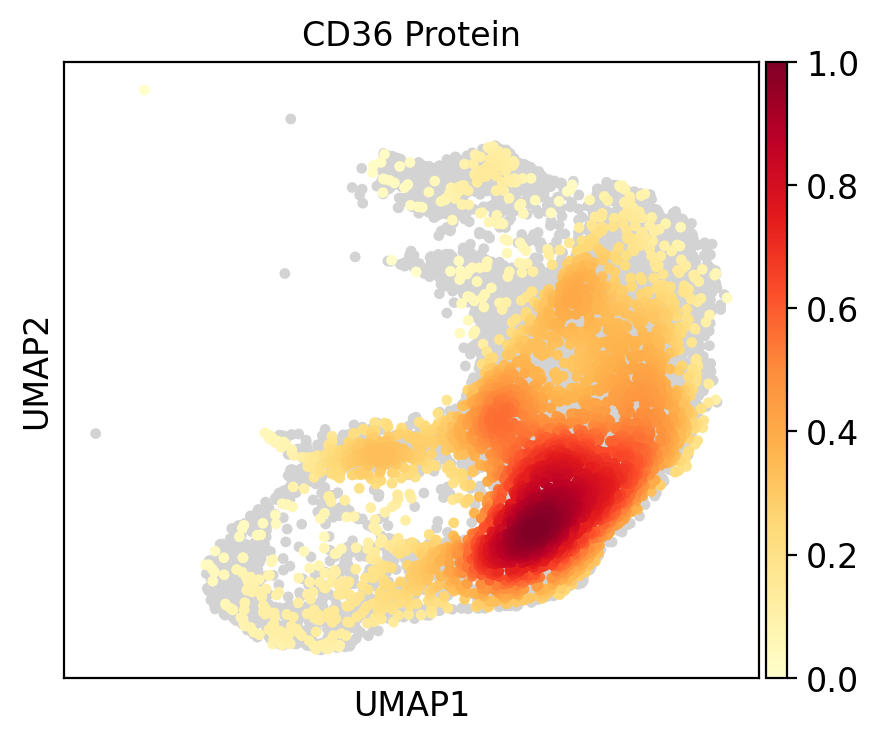

5.839735174342439


In [ ]:
density_plot(ad2Ex, gene='tsb-CD36', title='CD36 Protein', thr=None) 

##### CD71

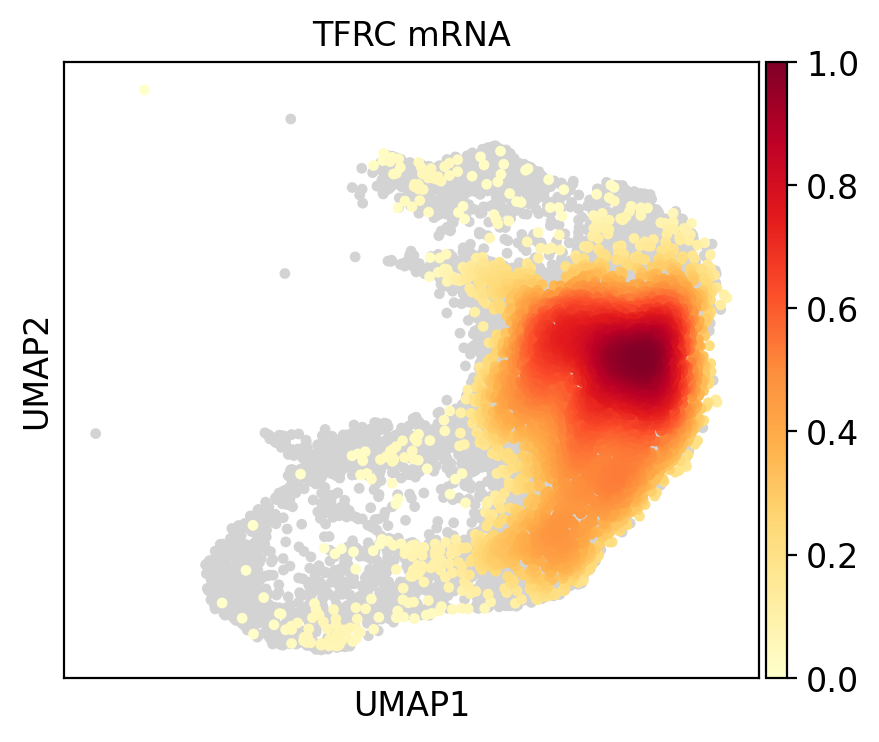

0.5375369191169739


In [ ]:
density_plot(ad2Ex, gene='TFRC', title='TFRC mRNA', thr=None) 

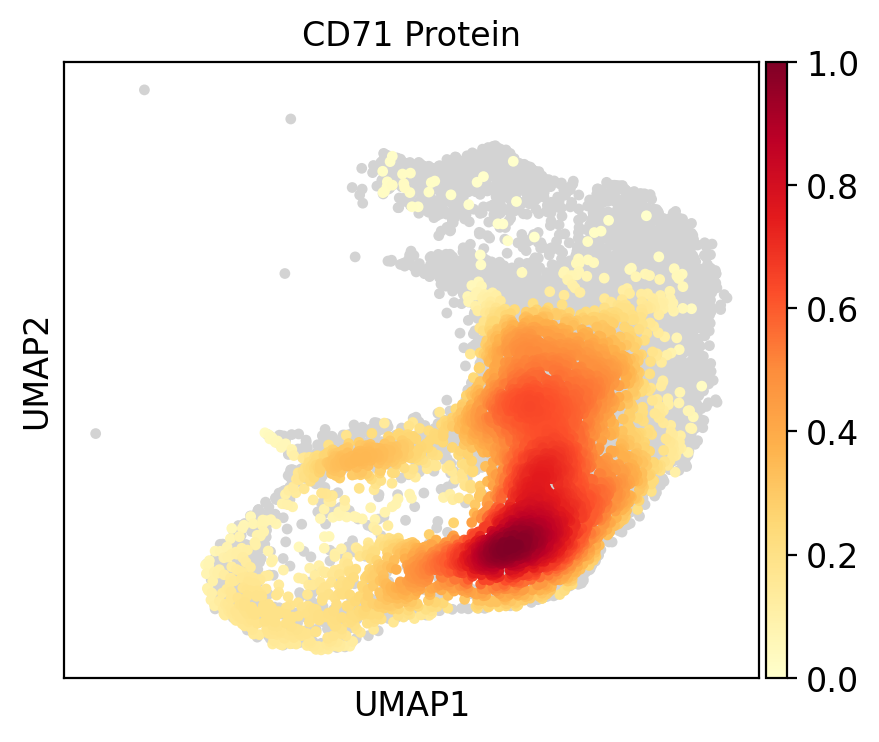

7.006233464735144


In [ ]:
density_plot(ad2Ex, gene='tsb-CD71', title='CD71 Protein', thr=None) 

##### GlyA CD235a

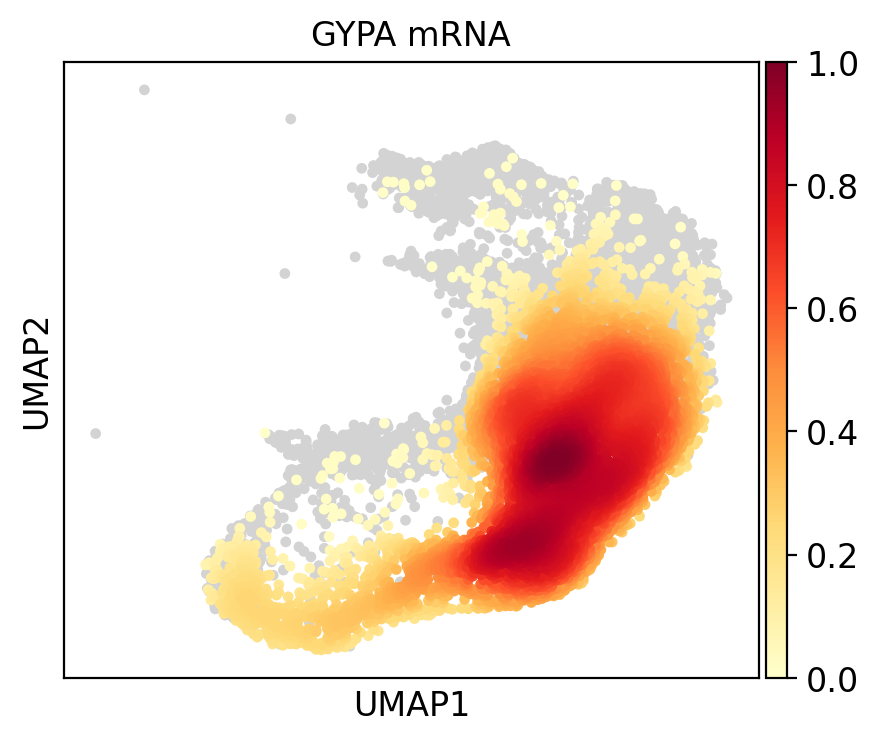

0.5322937965393066


In [ ]:
density_plot(ad2Ex, gene='GYPA', title='GYPA mRNA', thr=None) 

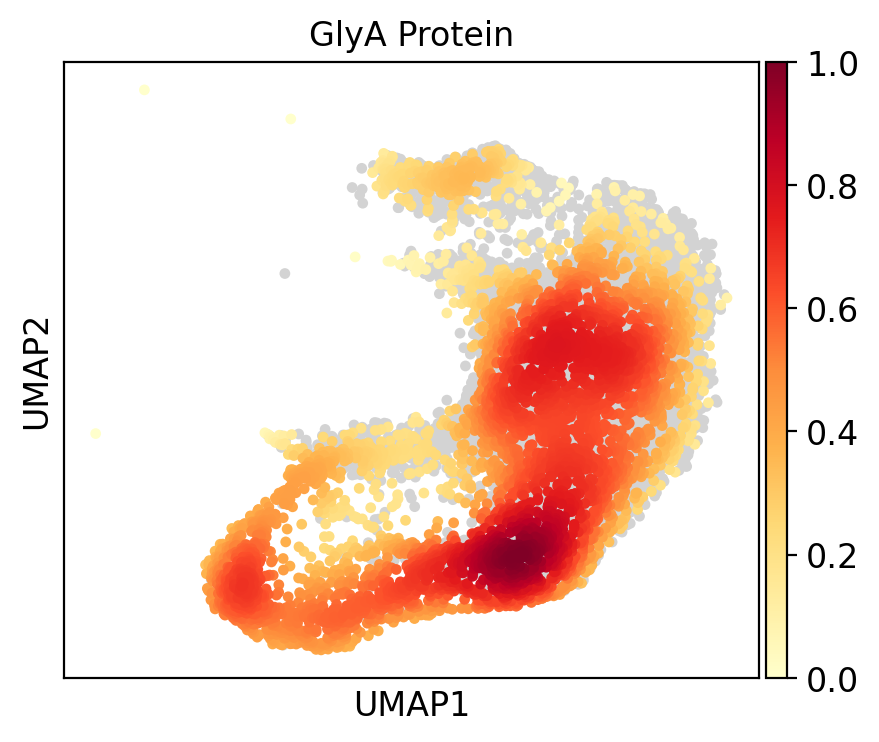

0.9576814293976703


In [ ]:
density_plot(ad2Ex, gene='tsb-CD235a', title='GlyA Protein', thr=None) 

### END